In [1]:
import sys
import os

# Add particle_detection to sys.path
sys.path.append(os.path.abspath(".."))

In [2]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import models
from torchvision.models import ResNet18_Weights

from particle_detection.data.dataset import create_dataloaders
from particle_detection.autoencoder.model import create_autoencoder
from particle_detection.autoencoder.utils import load_model

In [3]:
data_dir = "/home/blah-buttery/nanoparticles/images/normal"
# dataset_dir = "/Users/blah_m4/Desktop/nanoparticle/images" # macbook image location
image_size = (2048, 2048)
batch_size = 8

train_loader, test_loader = create_dataloaders(data_dir=data_dir, image_size=image_size, batch_size=batch_size)

In [4]:
# Path to the trained model
model_path = "../saved_models/ae_1000_epochs.pth"

# Set the device (GPU or CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Create and load the model
autoencoder = create_autoencoder().to(device)
autoencoder = load_model(autoencoder, model_path, device=device)
autoencoder.eval()  # Set the model to evaluation mode

print("Model loaded successfully.")

[DEBUG] Loading model from: ../saved_models/ae_1000_epochs.pth
[DEBUG] Model loaded successfully from ../saved_models/ae_1000_epochs.pth.
Model loaded successfully.


In [5]:
# get the latent space by passing dataset through encoder
sample_img = next(iter(test_loader))
sample_img = sample_img.to(device)

with torch.no_grad():
    latent_space = autoencoder.encoder(sample_img)
    print(f"Shape of latent space: {latent_space.shape}")

Shape of latent space: torch.Size([3, 512, 128, 128])


In [6]:
latent_space_reshaped = latent_space.permute(0, 2, 3, 1).reshape(-1, latent_space.shape[1])  # Shape: [N, C]
print(f"Shape of reshaped latent space: {latent_space_reshaped.shape}")

Shape of reshaped latent space: torch.Size([49152, 512])


In [20]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN

# Normalize the data
latent_space_normalized = StandardScaler().fit_transform(latent_space_reshaped.cpu().numpy())

# Apply DBSCAN with updated parameters
dbscan = DBSCAN(eps=10, min_samples=5)
cluster_labels = dbscan.fit_predict(latent_space_normalized)

# Count clusters and noise
num_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
num_noise_points = list(cluster_labels).count(-1)

print(f"Number of clusters found: {num_clusters}")
print(f"Number of noise points: {num_noise_points}")

Number of clusters found: 2
Number of noise points: 7604


In [21]:
# Map Cluster Labels Back to Spatial Grid
grid_cols = latent_space.shape[3]  # 1024 / 8 = 128
grid_rows = latent_space.shape[2]  # 1024 / 8 = 128
cluster_labels_grid = cluster_labels.reshape(latent_space.shape[0], grid_rows, grid_cols)  # Shape: [B, H, W

print(f"Cluster labels shape: {cluster_labels.shape}")
print(f"Cluster labels grid shape: {cluster_labels_grid.shape}")

Cluster labels shape: (49152,)
Cluster labels grid shape: (3, 128, 128)


In [22]:
def visualize_clusters_on_image(image_batch, cluster_labels_grid):
    """
    Visualize clusters directly on the spatial grid of the image.
    
    Args:
        image_batch (torch.Tensor): Batch of images, shape [B, C, H, W].
        cluster_labels_grid (np.ndarray): Cluster labels, shape [B, H, W].
    
    Returns:
        None
    """
    # Select the first image and its cluster labels
    single_image = image_batch[0]  # Shape: [C, H, W]
    single_cluster_labels = cluster_labels_grid[0]  # Shape: [H, W]

    # Visualize the image and clusters
    plt.figure(figsize=(12, 6))

    # Original Image
    plt.subplot(1, 2, 1)
    image_np = single_image.cpu().numpy().transpose(1, 2, 0)  # Convert CHW to HWC
    if image_np.max() > 1.0:
        image_np = image_np / 255.0  # Normalize
    plt.imshow(image_np, cmap="gray")
    plt.title("Original Image")
    plt.axis("off")

    # Cluster Overlay
    plt.subplot(1, 2, 2)
    plt.imshow(single_cluster_labels, cmap="viridis")
    plt.title("Cluster Visualization")
    plt.colorbar(label="Cluster")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

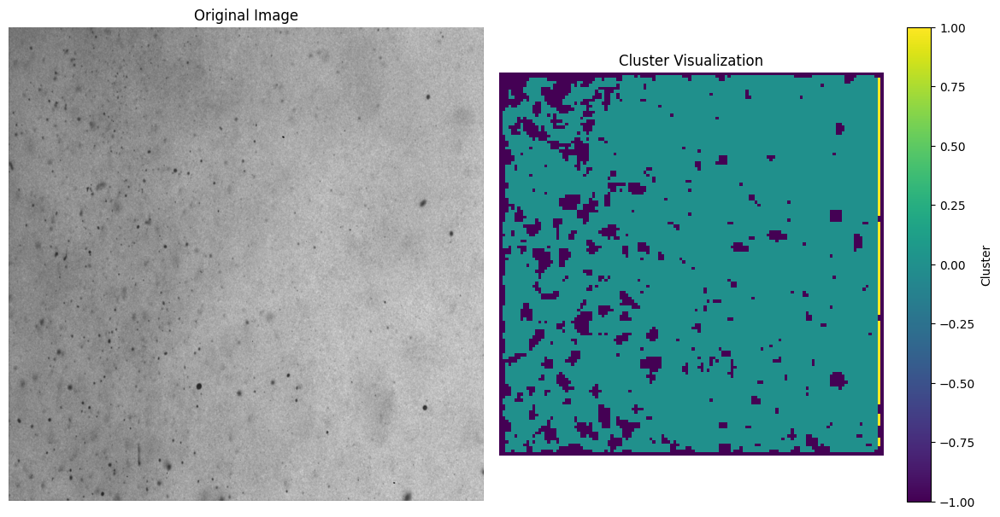

In [23]:
visualize_clusters_on_image(sample_img, cluster_labels_grid)

In [24]:
# okay, but can we improve the results?
# we can do this if we elimante some of the least important channels of the latent space
from sklearn.decomposition import PCA

# Convert PyTorch tensor to NumPy array
latent_space_np = latent_space_reshaped.cpu().numpy()  # Shape: [8192, 512]

# Apply PCA
n_components = 50  # Adjust based on your needs (e.g., explained variance)
pca = PCA(n_components=n_components)
latent_space_pca = pca.fit_transform(latent_space_np)  # Shape: [8192, 50]

print(f"Shape after PCA: {latent_space_pca.shape}")

Shape after PCA: (49152, 50)


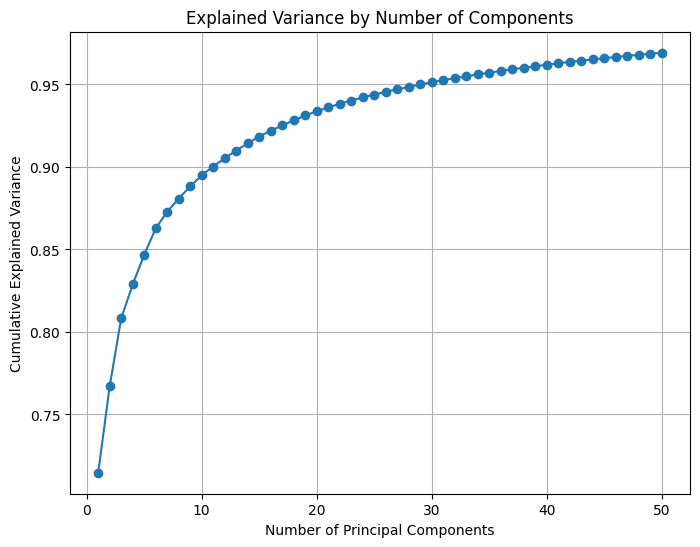

In [25]:
# Plot the explained variance
explained_variance_ratio = np.cumsum(pca.explained_variance_ratio_)
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o')
plt.xlabel("Number of Principal Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("Explained Variance by Number of Components")
plt.grid()
plt.show()

In [41]:
pca = PCA(n_components=20)
latent_space_pca = pca.fit_transform(latent_space_np)
print(f"Shape after PCA: {latent_space_pca.shape}")

Shape after PCA: (49152, 20)


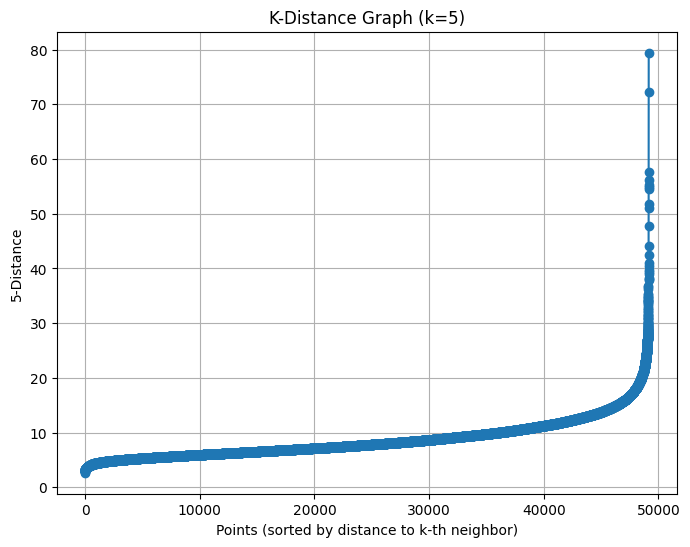

In [42]:
from sklearn.neighbors import NearestNeighbors

def plot_k_distance(data, k=5):
    """
    Plots the k-distance graph to help select the `eps` parameter for DBSCAN.
    
    Args:
        data (np.ndarray): Data for DBSCAN, shape [N, features].
        k (int): The k-th nearest neighbor to calculate distances for.
    
    Returns:
        None (plots the k-distance graph).
    """
    # Fit Nearest Neighbors model
    nbrs = NearestNeighbors(n_neighbors=k).fit(data)
    
    # Find distances to the k-th nearest neighbor for each point
    distances, _ = nbrs.kneighbors(data)
    
    # Extract the k-th nearest neighbor distances (column `k-1`)
    k_distances = np.sort(distances[:, k-1])  # Sort distances in ascending order
    
    # Plot the sorted k-distances
    plt.figure(figsize=(8, 6))
    plt.plot(k_distances, marker='o')
    plt.title(f"K-Distance Graph (k={k})")
    plt.xlabel("Points (sorted by distance to k-th neighbor)")
    plt.ylabel(f"{k}-Distance")
    plt.grid()
    plt.show()

# Example Usage:
plot_k_distance(latent_space_pca, k=5)  # Set k = min_samples - 1

In [172]:
# Apply DBSCAN
#latent_space_pca_normalized = StandardScaler().fit_transform(latent_space_pca)
dbscan = DBSCAN(eps=10.5, min_samples=10)  # Adjust eps and min_samples as needed
cluster_labels = dbscan.fit_predict(latent_space_pca)

In [173]:
# Map Cluster Labels Back to Spatial Grid
grid_cols = latent_space.shape[3]  # 1024 / 8 = 128
grid_rows = latent_space.shape[2]  # 1024 / 8 = 128
cluster_labels_grid = cluster_labels.reshape(latent_space.shape[0], grid_rows, grid_cols)  # Shape: [B, H, W

print(f"Cluster labels shape: {cluster_labels.shape}")
print(f"Cluster labels grid shape: {cluster_labels_grid.shape}")

Cluster labels shape: (49152,)
Cluster labels grid shape: (3, 128, 128)


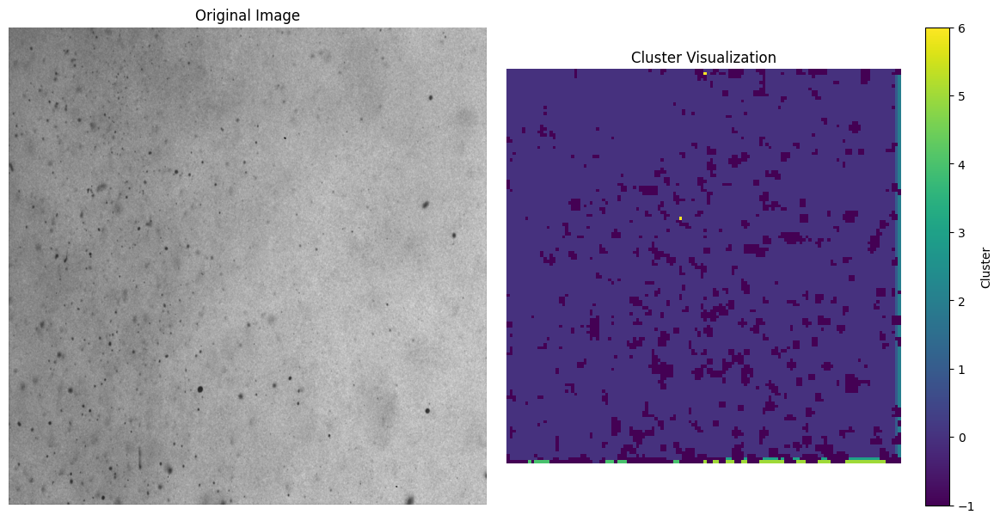

In [174]:
visualize_clusters_on_image(sample_img, cluster_labels_grid)

In [64]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import numpy as np

def dbscan_grid_search(data, eps_range, min_samples_range):
    """
    Perform a grid search for DBSCAN using eps and min_samples.

    Args:
        data: The dataset to cluster (array-like, shape: [n_samples, n_features]).
        eps_range: A range of values for the eps parameter.
        min_samples_range: A range of values for the min_samples parameter.

    Returns:
        best_model: The best DBSCAN model based on silhouette score.
        best_params: The best parameters found during the grid search.
        best_score: The highest silhouette score achieved.
    """
    best_model = None
    best_score = -1  # Silhouette score ranges from -1 to 1
    best_params = {}

    for eps in eps_range:
        for min_samples in min_samples_range:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)

            # Exclude cases where all points are noise or one cluster
            if len(set(labels)) > 1 and -1 in labels:
                score = silhouette_score(data, labels)
                print(f"Silhouette Score for eps={eps}, min_samples={min_samples}: {score}")

                if score > best_score:
                    best_score = score
                    best_model = dbscan
                    best_params = {"eps": eps, "min_samples": min_samples}

    print(f"Best parameters: {best_params}, Best Silhouette Score: {best_score}")
    return best_model, best_params, best_score

In [65]:
# Define ranges for eps and min_samples
eps_range = np.arange(0.5, 15, 0.1)  # Adjust range based on your data
min_samples_range = range(2, 10)

# Perform DBSCAN grid search
best_dbscan, best_params, best_score = dbscan_grid_search(latent_space_pca, eps_range, min_samples_range)

Silhouette Score for eps=1.8999999999999997, min_samples=2: 0.25872358679771423
Silhouette Score for eps=1.9999999999999996, min_samples=2: 0.20546464622020721
Silhouette Score for eps=2.0999999999999996, min_samples=2: 0.20552527904510498
Silhouette Score for eps=2.0999999999999996, min_samples=3: 0.260312557220459
Silhouette Score for eps=2.0999999999999996, min_samples=4: 0.260312557220459
Silhouette Score for eps=2.1999999999999997, min_samples=2: 0.15544742345809937
Silhouette Score for eps=2.1999999999999997, min_samples=3: 0.260312557220459
Silhouette Score for eps=2.1999999999999997, min_samples=4: 0.260312557220459
Silhouette Score for eps=2.3, min_samples=2: 0.15536515414714813
Silhouette Score for eps=2.3, min_samples=3: 0.2485809475183487
Silhouette Score for eps=2.3, min_samples=4: 0.260312557220459
Silhouette Score for eps=2.3999999999999995, min_samples=2: 0.1406286358833313
Silhouette Score for eps=2.3999999999999995, min_samples=3: 0.2485809475183487
Silhouette Score f

KeyboardInterrupt: 

In [66]:
import pandas as pd
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

def dbscan_grid_search_with_logging(data, eps_range, min_samples_range):
    """
    Optimized DBSCAN grid search to skip unnecessary computations.
    Skips to the next eps value if two consecutive negative silhouette scores are encountered.
    Logs all results for graphing.
    """
    best_model = None
    best_score = -1  # Silhouette score ranges from -1 to 1
    best_params = {}
    results = []  # Store results for graphing

    for eps in eps_range:
        negative_count = 0  # Track consecutive negative results

        for min_samples in min_samples_range:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)

            # Check for valid clustering
            if len(set(labels)) > 1 and -1 in labels:
                score = silhouette_score(data, labels)
                results.append({"eps": eps, "min_samples": min_samples, "score": score})
                print(f"Silhouette Score for eps={eps}, min_samples={min_samples}: {score}")

                # Update best model and parameters if score improves
                if score > best_score:
                    best_score = score
                    best_model = dbscan
                    best_params = {"eps": eps, "min_samples": min_samples}

                # Reset the negative count if score is positive
                if score > 0:
                    negative_count = 0
                else:
                    negative_count += 1
            else:
                # Treat invalid clustering as a negative result
                results.append({"eps": eps, "min_samples": min_samples, "score": -1})
                print(f"Invalid clustering for eps={eps}, min_samples={min_samples}")
                negative_count += 1

            # Skip to next eps if two consecutive negative results are encountered
            if negative_count >= 2:
                print(f"Skipping remaining min_samples for eps={eps} due to consecutive negative results.")
                break

    # Convert results to a DataFrame for easier graphing
    results_df = pd.DataFrame(results)
    print(f"Best parameters: {best_params}, Best Silhouette Score: {best_score}")
    return best_model, best_params, best_score, results_df

In [ ]:
# Define ranges for eps and min_samples
eps_range = np.arange(0.5, 15.0, 1.0)  # Adjust range as needed
min_samples_range = range(2, 10)

# Perform DBSCAN grid search
best_dbscan, best_params, best_score, results_df = dbscan_grid_search_with_logging(latent_space_pca, eps_range, min_samples_range)

# Example graphing
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
for min_samples in results_df["min_samples"].unique():
    subset = results_df[results_df["min_samples"] == min_samples]
    plt.plot(subset["eps"], subset["score"], label=f"min_samples={min_samples}")

plt.title("DBSCAN Silhouette Scores")
plt.xlabel("eps")
plt.ylabel("Silhouette Score")
plt.legend()
plt.grid()
plt.show()

Invalid clustering for eps=0.5, min_samples=2
Invalid clustering for eps=0.5, min_samples=3
Skipping remaining min_samples for eps=0.5 due to consecutive negative results.
Invalid clustering for eps=1.5, min_samples=2
Invalid clustering for eps=1.5, min_samples=3
Skipping remaining min_samples for eps=1.5 due to consecutive negative results.
Silhouette Score for eps=2.5, min_samples=2: -0.45942172408103943
Silhouette Score for eps=2.5, min_samples=3: 0.21006907522678375
Silhouette Score for eps=2.5, min_samples=4: 0.260312557220459
Invalid clustering for eps=2.5, min_samples=5
Invalid clustering for eps=2.5, min_samples=6
Skipping remaining min_samples for eps=2.5 due to consecutive negative results.
Silhouette Score for eps=3.5, min_samples=2: -0.6940658688545227
Silhouette Score for eps=3.5, min_samples=3: -0.5800540447235107
Skipping remaining min_samples for eps=3.5 due to consecutive negative results.
Silhouette Score for eps=4.5, min_samples=2: -0.6822978854179382
Silhouette Scor

Unique cluster labels: [-1  0  1  2  3  4  5  6  7]


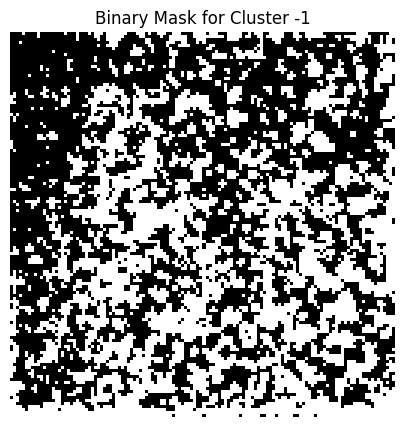

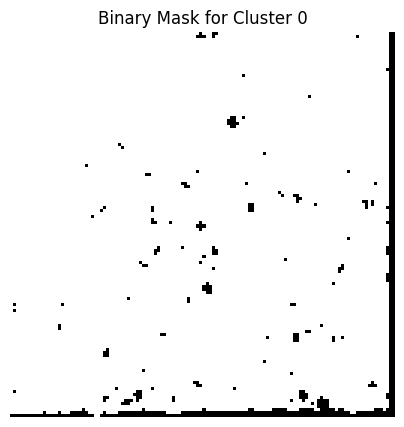

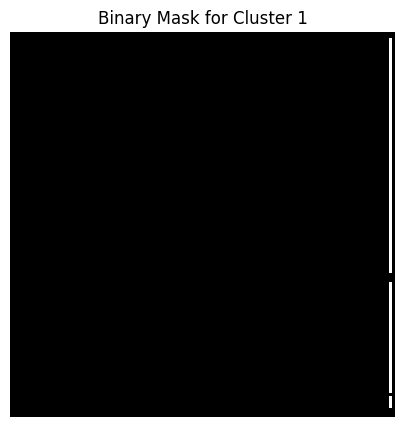

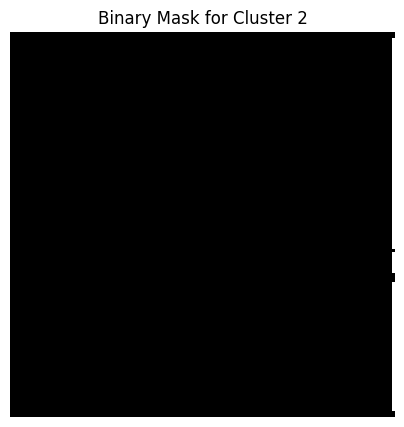

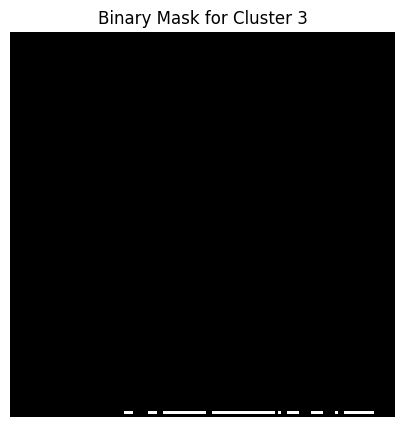

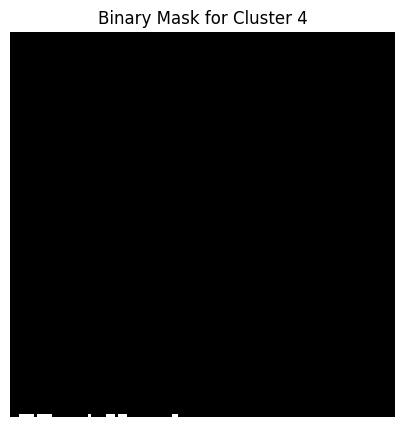

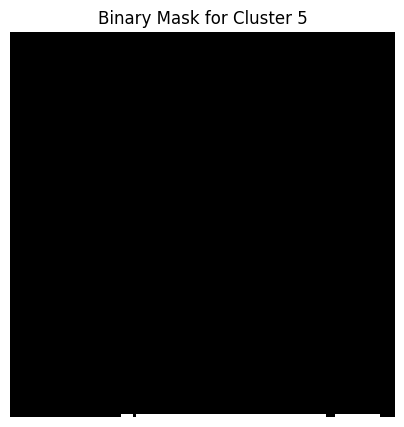

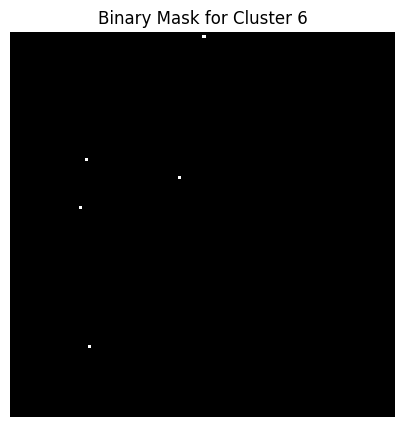

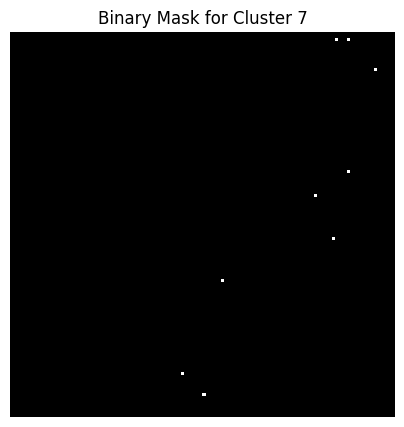

In [214]:
def display_binary_masks(cluster_labels_grid):
    """
    Display binary masks for each unique cluster in the cluster labels grid.

    Args:
        cluster_labels_grid (np.ndarray): Cluster labels grid, shape [B, H, W].

    Returns:
        None: Displays binary masks for each cluster.
    """
    # Print unique cluster labels
    unique_clusters = np.unique(cluster_labels_grid)
    print(f"Unique cluster labels: {unique_clusters}")

    # Iterate over unique clusters and display binary masks
    for cluster in unique_clusters:
        # Create a binary mask for the current cluster
        cluster_mask = (cluster_labels_grid == cluster).astype(np.uint8)

        if cluster_mask.ndim == 3:  # If 3D mask, sum along the batch dimension
            cluster_mask = np.sum(cluster_mask, axis=0)
        cluster_mask = (cluster_mask > 0).astype(np.uint8)

        # Display the binary mask
        plt.figure(figsize=(5, 5))
        plt.imshow(cluster_mask, cmap='gray')
        plt.title(f"Binary Mask for Cluster {cluster}")
        plt.axis("off")
        plt.show()

# Display binary masks for each cluster
display_binary_masks(cluster_labels_grid)


In [142]:
def visualize_single_cluster_contour(
    sample_img, cluster_labels_grid, cluster_id_to_display, scale_factor=16, save_path=None
):
    """
    Visualize a single cluster with contours overlaid on the original image.

    Args:
        sample_img (torch.Tensor): Grayscale image tensor, shape [1, 1, H, W] or [1, H, W].
        cluster_labels_grid (np.ndarray): Cluster labels grid, shape [B, H, W].
        cluster_id_to_display (int): The specific cluster label to isolate and display.
        scale_factor (int): Scaling factor to map latent space to original dimensions.
        save_path (str): Optional. Path to save the output visualization.

    Returns:
        None: Displays or saves the image with contours for the specified cluster.
    """
    # Adjust for different input shapes
    if len(sample_img.shape) == 3:  # [1, H, W]
        sample_img = sample_img.unsqueeze(0)  # Add the missing dimension to make it [1, 1, H, W]
    elif len(sample_img.shape) != 4:
        raise ValueError("sample_img must have shape [1, 1, H, W] or [1, H, W].")

    if len(cluster_labels_grid.shape) != 3:  # [B, H, W]
        raise ValueError("cluster_labels_grid must have shape [B, H, W].")

    # Convert the image to NumPy
    image_np = sample_img[0, 0].cpu().numpy()  # Shape: [H, W]
    original_h, original_w = image_np.shape

    # Convert the grayscale image to RGB for visualization
    image_colored = cv2.cvtColor(image_np, cv2.COLOR_GRAY2BGR)

    # Ensure the cluster labels grid is resized to match the original image size
    cluster_labels_resized = cv2.resize(
        cluster_labels_grid[0], (original_w, original_h), interpolation=cv2.INTER_NEAREST
    )

    # Create a binary mask for the specified cluster
    mask = (cluster_labels_resized == cluster_id_to_display).astype(np.uint8)

    # Debugging: Verify the mask
    print(f"Displaying cluster ID: {cluster_id_to_display}")
    print(f"Number of pixels in cluster: {np.sum(mask)}")

    # Find contours for the specified cluster
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Draw contours for the cluster
    cv2.drawContours(image_colored, contours, -1, (0, 255, 0), thickness=2)  # Green for contours

    # Visualize the final result
    plt.figure(figsize=(12, 12))
    plt.imshow(image_colored)
    plt.title(f"Cluster {cluster_id_to_display} with Contours")
    plt.axis("off")
    plt.show()

    # Optionally save the image
    if save_path:
        cv2.imwrite(save_path, cv2.cvtColor(image_colored, cv2.COLOR_BGR2RGB))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Displaying cluster ID: -1
Number of pixels in cluster: 454144


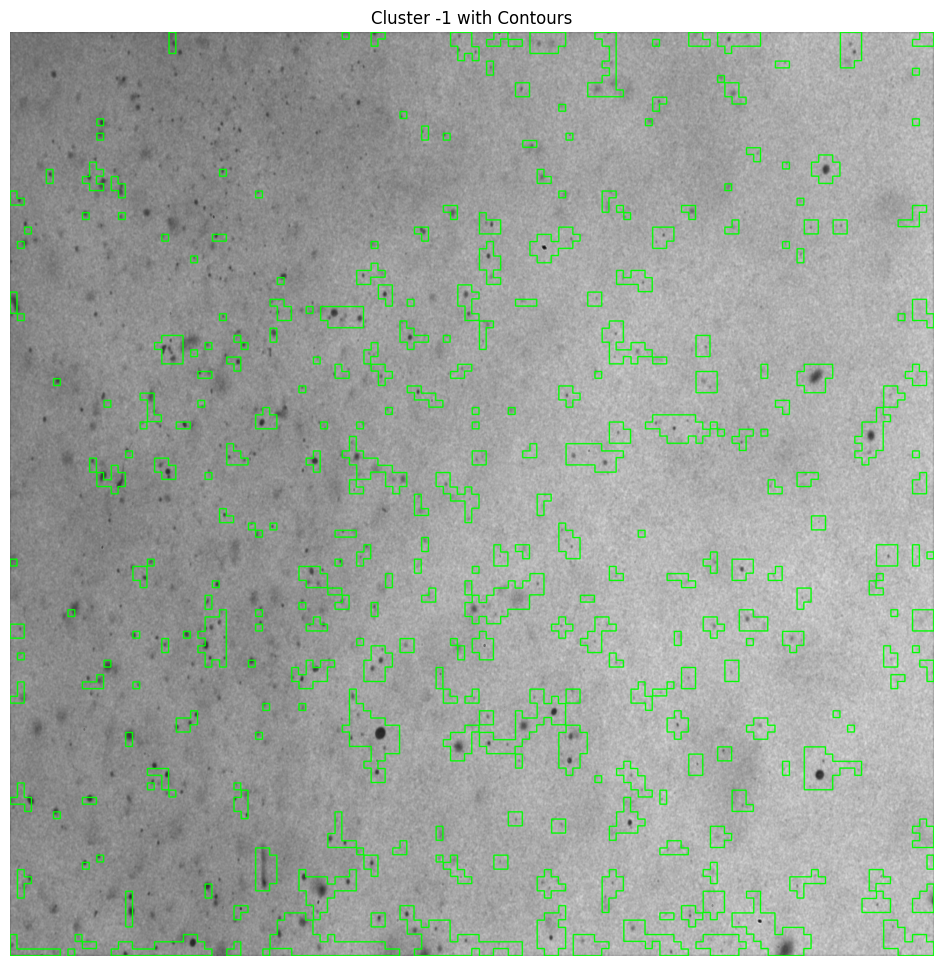

In [178]:
cluster_id = -1

# Call the function
visualize_single_cluster_contour(sample_img, cluster_labels_grid, cluster_id_to_display=cluster_id, scale_factor=16)

In [93]:
def filter_particles_by_size_and_shape(sample_img, cluster_labels_grid, cluster_id_to_display, min_area=10, max_area=500, min_circularity=0.7):
    """
    Filter particles based on size and shape and overlay contours on the image.

    Args:
        sample_img (torch.Tensor): Grayscale image tensor, shape [1, 1, H, W].
        cluster_labels_grid (np.ndarray): Cluster labels grid, shape [B, H, W].
        cluster_id_to_display (int): The specific cluster label to isolate and filter.
        min_area (int): Minimum area of a valid particle.
        max_area (int): Maximum area of a valid particle.
        min_circularity (float): Minimum circularity of a valid particle (0 to 1).
    
    Returns:
        None: Displays the filtered particles overlaid on the image.
    """
    # Convert the image to NumPy
    image_np = sample_img[0, 0].cpu().numpy()  # Shape: [H, W]
    original_h, original_w = image_np.shape

    # Upscale the image to match the original size
    image_resized = cv2.resize(
        image_np, (original_w, original_h), interpolation=cv2.INTER_LINEAR
    )
    image_colored = cv2.cvtColor(image_resized, cv2.COLOR_GRAY2BGR)  # Convert to RGB

    # Upscale the cluster labels to match the original image size
    cluster_labels_resized = cv2.resize(
        cluster_labels_grid[0],
        (original_w, original_h),
        interpolation=cv2.INTER_NEAREST,
    )

    # Create a binary mask for the specified cluster
    mask = (cluster_labels_resized == cluster_id_to_display).astype(np.uint8)

    # Find contours for the specified cluster
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by size and shape
    valid_contours = []
    for contour in contours:
        area = cv2.contourArea(contour)
        if min_area <= area <= max_area:
            # Calculate circularity
            perimeter = cv2.arcLength(contour, True)
            if perimeter == 0:
                continue
            circularity = 4 * np.pi * (area / (perimeter ** 2))
            if circularity >= min_circularity:
                valid_contours.append(contour)

    # Debugging: Print the number of valid contours
    print(f"Total contours found: {len(contours)}")
    print(f"Valid particles after filtering: {len(valid_contours)}")

    # Draw valid contours
    cv2.drawContours(image_colored, valid_contours, -1, (0, 255, 0), thickness=2)  # Green for valid contours

    # Visualize the final result
    plt.figure(figsize=(12, 12))
    plt.imshow(image_colored)
    plt.title(f"Filtered Particles from Cluster {cluster_id_to_display}")
    plt.axis("off")
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Total contours found: 271
Valid particles after filtering: 245


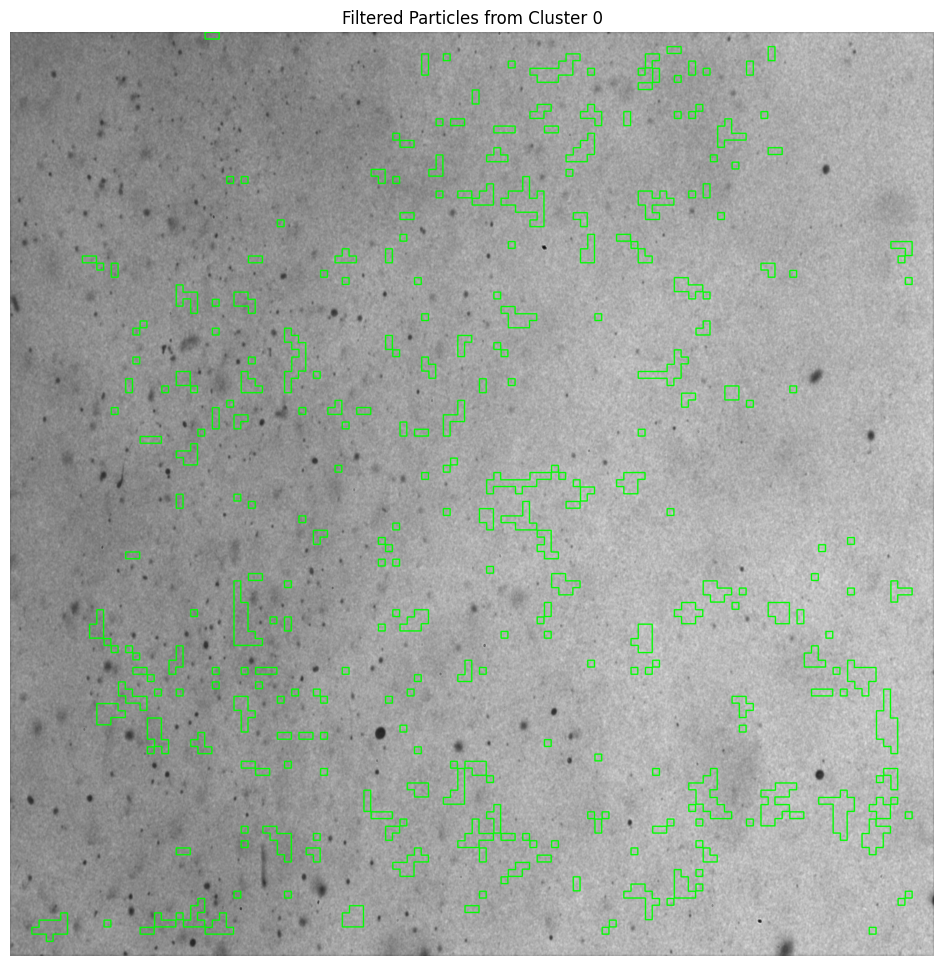

In [171]:
filter_particles_by_size_and_shape(
    sample_img=sample_img,
    cluster_labels_grid=cluster_labels_grid,
    cluster_id_to_display=0,  # Replace with the cluster ID to filter
    min_area=0.1,              # Minimum particle size
    max_area=5000,             # Maximum particle size
    min_circularity=0.1       # Minimum circularity (close to 1 for near-circles)
)

In [160]:
def display_all_clusters_and_filter_by_size(
    sample_img, cluster_labels_grid, min_area=10, max_area=500
):
    """
    Display all clusters and then apply size-based filtering to isolate particles.

    Args:
        sample_img (torch.Tensor): Grayscale image tensor, shape [1, 1, H, W].
        cluster_labels_grid (np.ndarray): Cluster labels grid, shape [B, H, W].
        min_area (int): Minimum area of a valid particle.
        max_area (int): Maximum area of a valid particle.

    Returns:
        None: Displays the image with all clusters and filtered particles.
    """
    # Convert the image to NumPy
    image_np = sample_img[0, 0].cpu().numpy()  # Shape: [H, W]
    original_h, original_w = image_np.shape

    # Upscale the image to match the original size
    image_resized = cv2.resize(
        image_np, (original_w, original_h), interpolation=cv2.INTER_LINEAR
    )
    image_colored = cv2.cvtColor(image_resized, cv2.COLOR_GRAY2BGR)  # Convert to RGB

    # Upscale the cluster labels to match the original image size
    cluster_labels_resized = cv2.resize(
        cluster_labels_grid[0],
        (original_w, original_h),
        interpolation=cv2.INTER_NEAREST,
    )

    # Create a binary mask for all clusters
    unique_clusters = np.unique(cluster_labels_resized)
    all_contours = []
    for cluster_id in unique_clusters:
        mask = (cluster_labels_resized == cluster_id).astype(np.uint8)
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        all_contours.extend(contours)

    # Visualize all clusters
    image_all_clusters = image_colored.copy()
    cv2.drawContours(image_all_clusters, all_contours, -1, (0, 255, 0), thickness=1)  # Green for all contours
    plt.figure(figsize=(12, 12))
    plt.imshow(image_all_clusters)
    plt.title("All Clusters with Contours")
    plt.axis("off")
    plt.show()

    # Apply size filtering
    valid_contours = [
        contour
        for contour in all_contours
        if min_area <= cv2.contourArea(contour) <= max_area
    ]

    # Visualize filtered contours
    image_filtered = image_colored.copy()
    cv2.drawContours(image_filtered, valid_contours, -1, (255, 0, 0), thickness=2)  # Blue for valid contours
    plt.figure(figsize=(12, 12))
    plt.imshow(image_filtered)
    plt.title(f"Filtered Particles (Area: {min_area}-{max_area})")
    plt.axis("off")
    plt.show()

    # Debugging: Print total contours and filtered contours
    print(f"Total contours found: {len(all_contours)}")
    print(f"Valid contours after filtering: {len(valid_contours)}")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


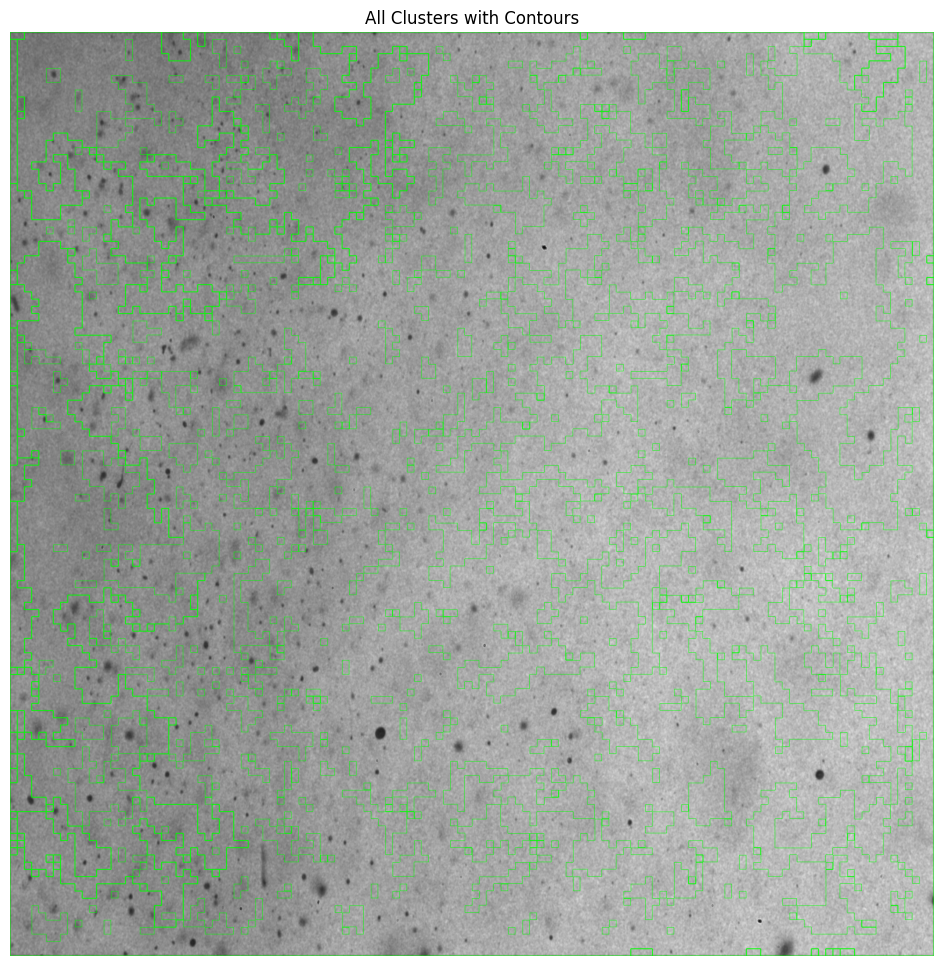

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


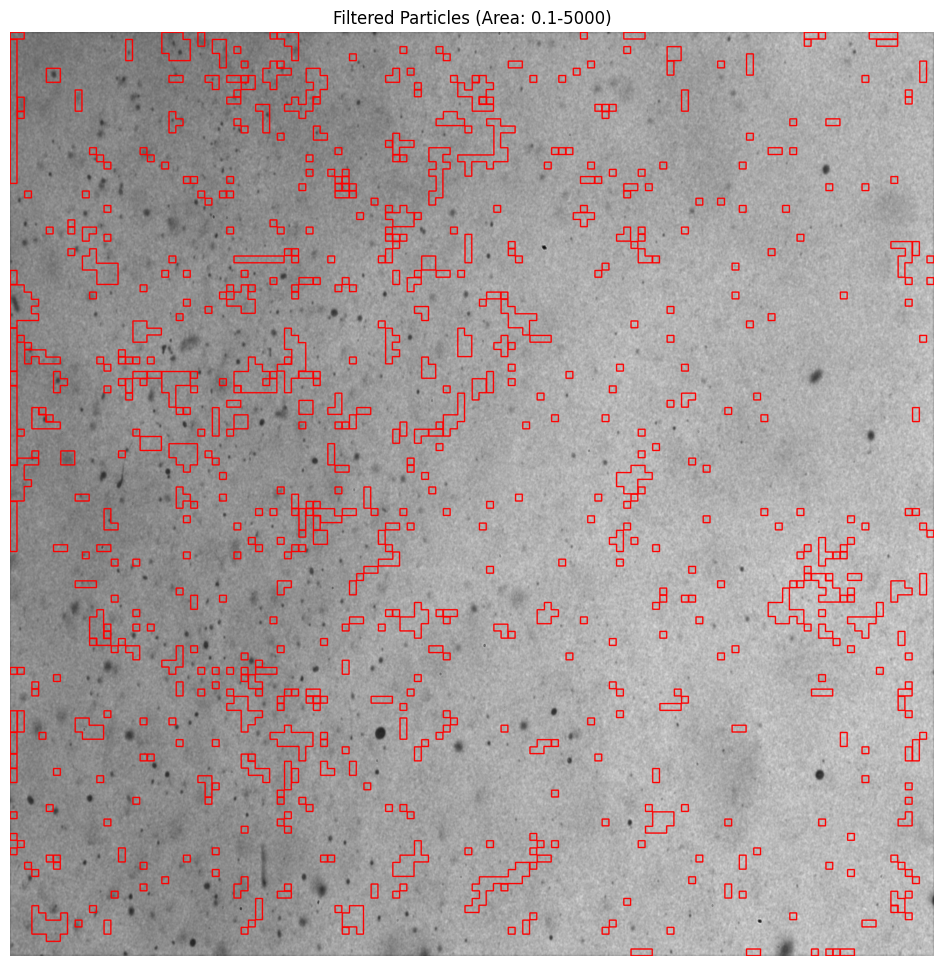

Total contours found: 650
Valid contours after filtering: 620


In [161]:
display_all_clusters_and_filter_by_size(
    sample_img=sample_img,
    cluster_labels_grid=cluster_labels_grid,
    min_area=0.1,    # Adjust to match expected particle size
    max_area=5000,  # Adjust to match expected particle size
)

In [99]:
def display_all_clusters_and_filter_by_size(
    sample_img, cluster_labels_grid, min_area=10, max_area=500
):
    """
    Display all clusters and apply size-based filtering to isolate particles.
    Returns the valid contours for further processing.

    Args:
        sample_img (torch.Tensor): Grayscale image tensor, shape [1, 1, H, W].
        cluster_labels_grid (np.ndarray): Cluster labels grid, shape [B, H, W].
        min_area (int): Minimum area of a valid particle.
        max_area (int): Maximum area of a valid particle.

    Returns:
        valid_contours (list): List of filtered contours that meet size criteria.
    """
    # Convert the image to NumPy
    image_np = sample_img[0, 0].cpu().numpy()  # Shape: [H, W]
    original_h, original_w = image_np.shape

    # Upscale the image to match the original size
    image_resized = cv2.resize(
        image_np, (original_w, original_h), interpolation=cv2.INTER_LINEAR
    )
    image_colored = cv2.cvtColor(image_resized, cv2.COLOR_GRAY2BGR)  # Convert to RGB

    # Upscale the cluster labels to match the original image size
    cluster_labels_resized = cv2.resize(
        cluster_labels_grid[0],
        (original_w, original_h),
        interpolation=cv2.INTER_NEAREST,
    )

    # Create a binary mask for all clusters
    unique_clusters = np.unique(cluster_labels_resized)
    all_contours = []
    for cluster_id in unique_clusters:
        mask = (cluster_labels_resized == cluster_id).astype(np.uint8)
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        all_contours.extend(contours)

    # Visualize all clusters
    image_all_clusters = image_colored.copy()
    cv2.drawContours(image_all_clusters, all_contours, -1, (0, 255, 0), thickness=1)  # Green for all contours
    plt.figure(figsize=(12, 12))
    plt.imshow(image_all_clusters)
    plt.title("All Clusters with Contours")
    plt.axis("off")
    plt.show()

    # Apply size filtering
    valid_contours = [
        contour
        for contour in all_contours
        if min_area <= cv2.contourArea(contour) <= max_area
    ]

    # Visualize filtered contours
    image_filtered = image_colored.copy()
    cv2.drawContours(image_filtered, valid_contours, -1, (255, 0, 0), thickness=2)  # Blue for valid contours
    plt.figure(figsize=(12, 12))
    plt.imshow(image_filtered)
    plt.title(f"Filtered Particles (Area: {min_area}-{max_area})")
    plt.axis("off")
    plt.show()

    # Debugging: Print total contours and filtered contours
    print(f"Total contours found: {len(all_contours)}")
    print(f"Valid contours after filtering: {len(valid_contours)}")

    # Return the valid contours
    return valid_contours


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


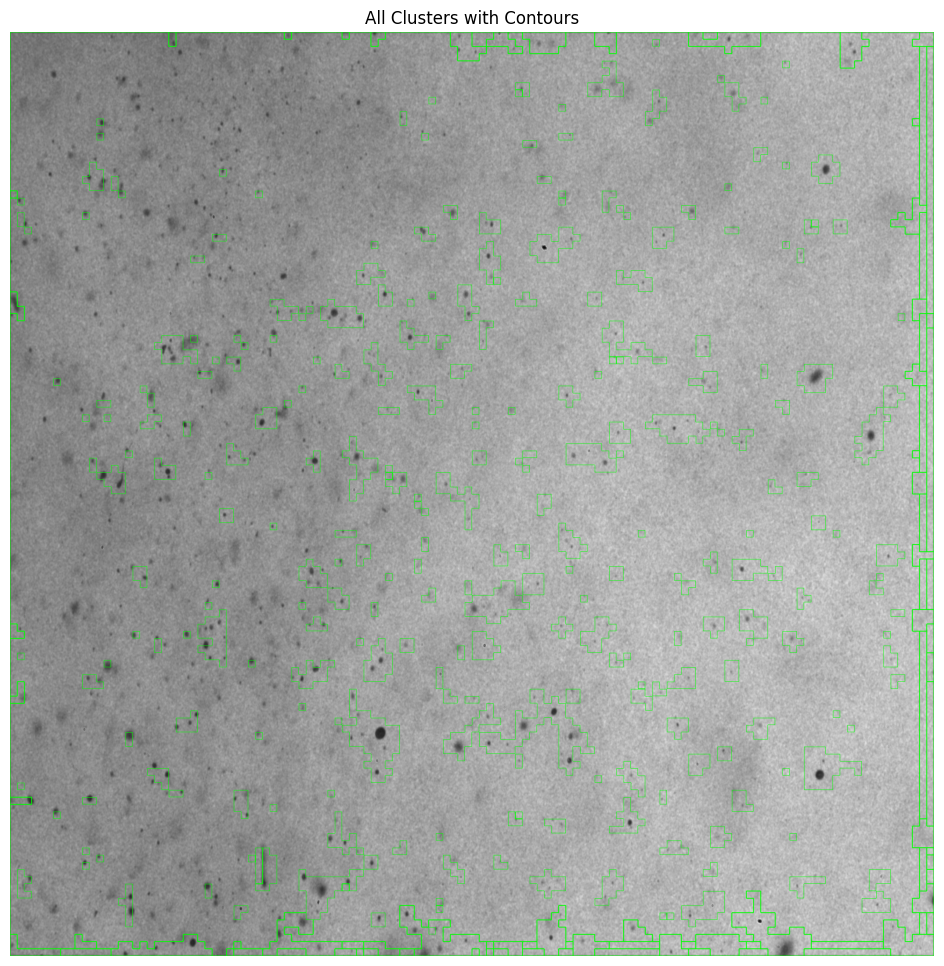

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


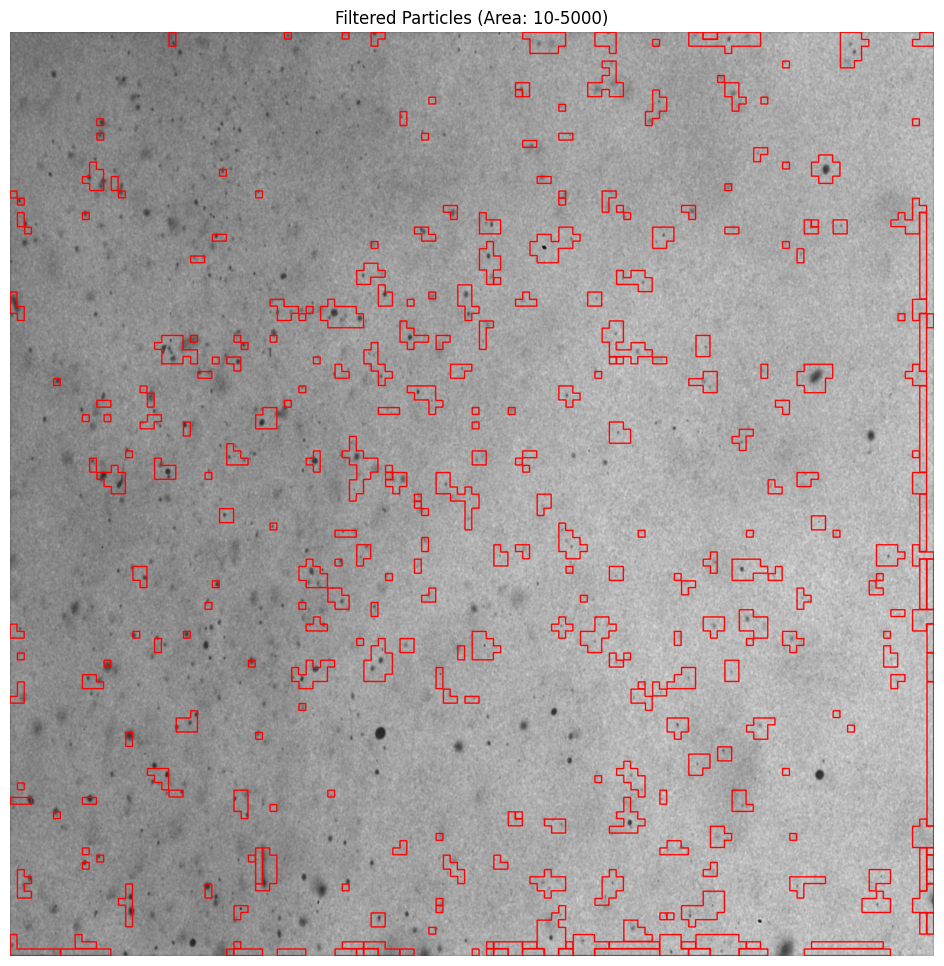

Total contours found: 328
Valid contours after filtering: 309
Number of valid particles: 309


In [102]:
# Call the function to filter contours
valid_contours = display_all_clusters_and_filter_by_size(
    sample_img=sample_img,
    cluster_labels_grid=cluster_labels_grid,
    min_area=10,    # Minimum particle size
    max_area=5000    # Maximum particle size
)

# Use valid_contours for further processing
print(f"Number of valid particles: {len(valid_contours)}")


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Cluster ID: 0, Pixels: 3667456
Cluster ID: 1, Pixels: 26368
Cluster ID: 2, Pixels: 27136
Cluster ID: 3, Pixels: 5888
Cluster ID: 4, Pixels: 3584
Cluster ID: 5, Pixels: 9216
Cluster ID: 6, Pixels: 512
Valid Contours after Filtering: 88


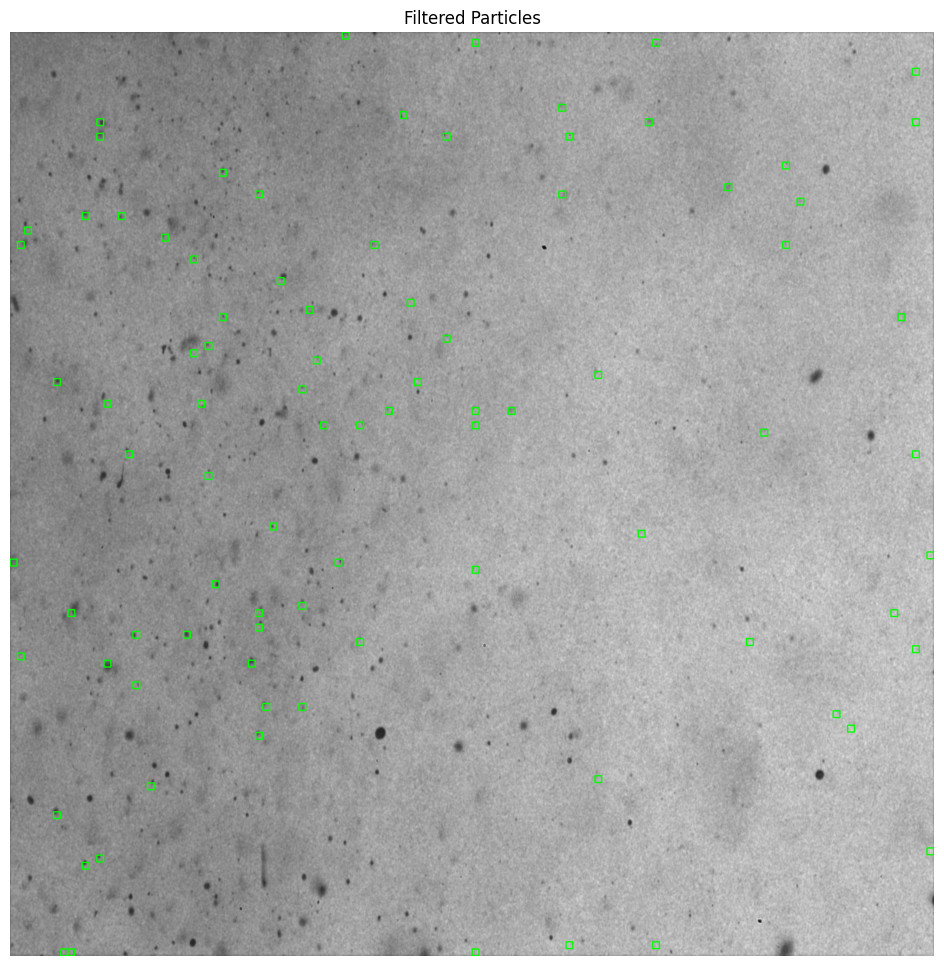

In [180]:
process_and_visualize_clusters(
    sample_img, cluster_labels_grid, cluster_id=None, min_area=10, max_area=500, debug=True
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Cluster ID: 0, Pixels: 3667456
Cluster ID: 1, Pixels: 26368
Cluster ID: 2, Pixels: 27136
Cluster ID: 3, Pixels: 5888
Cluster ID: 4, Pixels: 3584
Cluster ID: 5, Pixels: 9216
Cluster ID: 6, Pixels: 512


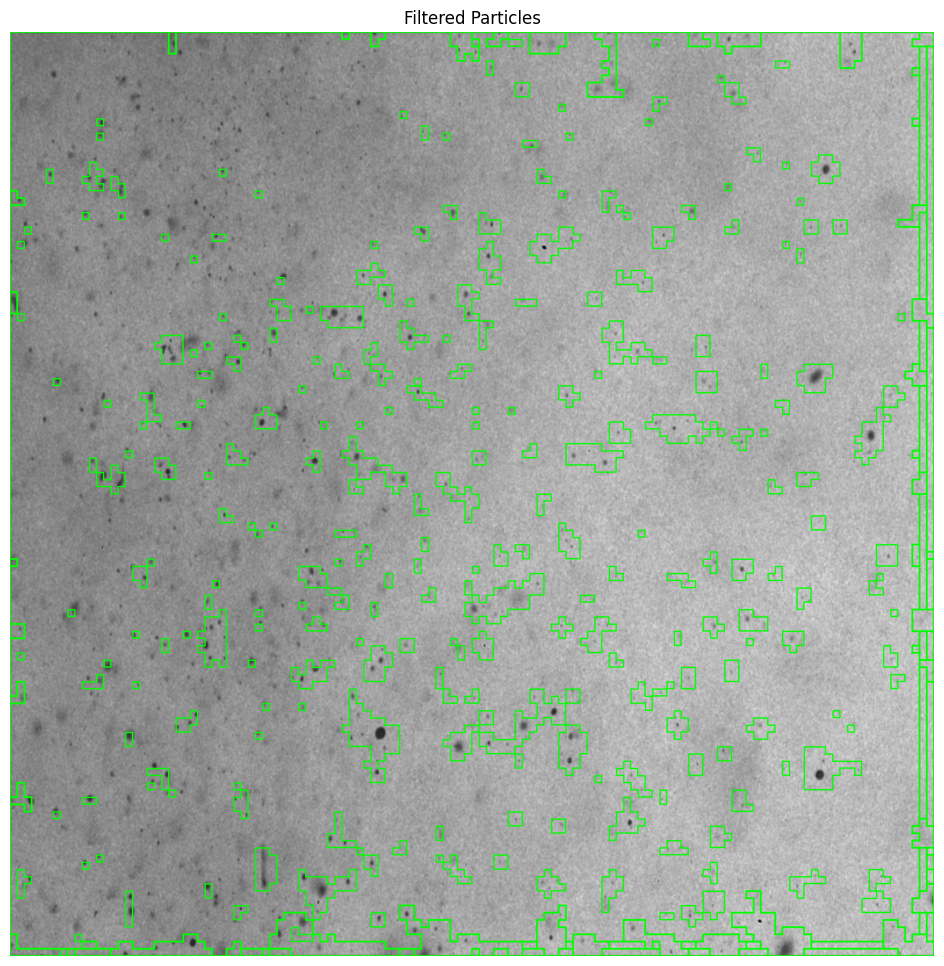

In [181]:
process_and_visualize_clusters(
    sample_img, cluster_labels_grid, cluster_id=None, no_filter=True, debug=True
)

In [202]:
def resize_and_convert(image, target_shape, to_rgb=False):
    resized = cv2.resize(image, target_shape, interpolation=cv2.INTER_NEAREST)
    if to_rgb:
        return cv2.cvtColor(resized, cv2.COLOR_GRAY2BGR)
    return resized

def get_contours(mask):
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return contours

def filter_contours_by_area_and_shape(contours, min_area, max_area, min_circularity):
    valid_contours = []
    for contour in contours:
        area = cv2.contourArea(contour)
        if min_area <= area <= max_area:
            perimeter = cv2.arcLength(contour, True)
            if perimeter > 0:
                circularity = 4 * np.pi * (area / (perimeter ** 2))
                if circularity >= min_circularity:
                    valid_contours.append(contour)
    return valid_contours

def draw_and_display(image, contours, title=None, color=(0, 255, 0), thickness=2, save_path=None):
    image_copy = image.copy()
    cv2.drawContours(image_copy, contours, -1, color, thickness)
    
    plt.figure(figsize=(12, 12))
    plt.imshow(image_copy)
    plt.title(title if title is not None else "Visualization")
    plt.axis("off")
    plt.show()

    if save_path:
        # Ensure image is in 8-bit format before saving
        if image_copy.dtype != np.uint8:
            image_copy = cv2.normalize(image_copy, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
        cv2.imwrite(save_path, cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB))


def process_and_visualize_clusters(
    sample_img, cluster_labels_grid, cluster_id=None, min_area=10, max_area=500, min_circularity=0.7, debug=False, save_path=None, no_filter=False, title=None
):
    """
    Process and visualize clusters with options for filtering and focusing on specific clusters.

    Args:
        sample_img (torch.Tensor): Grayscale image tensor, shape [1, 1, H, W].
        cluster_labels_grid (np.ndarray): Cluster labels grid, shape [B, H, W].
        cluster_id (int): Specific cluster to focus on (None for all clusters).
        min_area (int): Minimum area for filtering particles.
        max_area (int): Maximum area for filtering particles.
        min_circularity (float): Minimum circularity for filtering particles.
        debug (bool): If True, print debug information.
        save_path (str): Optional. Path to save the final visualization.
        no_filter (bool): If True, skips filtering by size and circularity.
        title (str): Custom title for the visualization.
    """
    # Convert and resize
    image_np = sample_img[0, 0].cpu().numpy()
    original_h, original_w = image_np.shape
    image_colored = resize_and_convert(image_np, (original_w, original_h), to_rgb=True)
    cluster_labels_resized = resize_and_convert(cluster_labels_grid[0], (original_w, original_h))

    if cluster_id is not None:
        # Focus on a single cluster
        mask = (cluster_labels_resized == cluster_id).astype(np.uint8)
        contours = get_contours(mask)
        if debug:
            print(f"Cluster ID: {cluster_id}, Pixels: {np.sum(mask)}, Total Contours: {len(contours)}")
    else:
        # Process all clusters
        contours = []
        for unique_id in np.unique(cluster_labels_resized):
            mask = (cluster_labels_resized == unique_id).astype(np.uint8)
            contours.extend(get_contours(mask))
            if debug and unique_id != -1:
                print(f"Cluster ID: {unique_id}, Pixels: {np.sum(mask)}")

    if no_filter:
        valid_contours = contours
    else:
        # Filter contours by size and shape
        valid_contours = filter_contours_by_area_and_shape(contours, min_area, max_area, min_circularity)
        if debug:
            print(f"Valid Contours after Filtering: {len(valid_contours)}")

    # Draw and display results
    draw_and_display(
        image_colored, valid_contours, title=title if title else ("Filtered Particles" if cluster_id is None else f"Cluster {cluster_id}"),
        save_path=save_path
    )
"""
# Comprehensive Testing Cases

# Example 1: Visualize all clusters with default filtering
process_and_visualize_clusters(sample_img, cluster_labels_grid)

# Example 2: Visualize all clusters without filtering
process_and_visualize_clusters(sample_img, cluster_labels_grid, no_filter=True)

# Example 3: Process and visualize a single cluster with filtering
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=2)

# Example 4: Process and visualize a single cluster without filtering
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=2, no_filter=True)

# Example 5: Set a stricter minimum area
process_and_visualize_clusters(sample_img, cluster_labels_grid, min_area=50)

# Example 6: Set a very small maximum area
process_and_visualize_clusters(sample_img, cluster_labels_grid, max_area=30)

# Example 7: Adjust the circularity requirement
process_and_visualize_clusters(sample_img, cluster_labels_grid, min_circularity=0.9)

# Example 8: Enable debug mode
process_and_visualize_clusters(sample_img, cluster_labels_grid, debug=True)

# Example 9: Debug a specific cluster
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=3, debug=True)

# Example 10: Set a custom title
process_and_visualize_clusters(sample_img, cluster_labels_grid, title="Custom Cluster Visualization")

# Example 11: Save the output image
process_and_visualize_clusters(sample_img, cluster_labels_grid, save_path="output.png")

# Example 12: Save visualization with a title
process_and_visualize_clusters(sample_img, cluster_labels_grid, save_path="output_titled.png", title="Saved Visualization")

# Example 13: Pass an empty cluster grid
empty_cluster_grid = np.zeros_like(cluster_labels_grid)
process_and_visualize_clusters(sample_img, empty_cluster_grid)

# Example 14: Pass an invalid cluster ID
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=999)

# Example 15: Pass an invalid image shape
invalid_img = torch.randn(3, 224, 224)  # Incorrect shape (should be [1,1,H,W])
try:
    process_and_visualize_clusters(invalid_img, cluster_labels_grid)
except ValueError as e:
    print("Expected Error:", e)

# Example 16: Pass an invalid cluster labels shape
invalid_cluster_grid = np.random.randint(0, 5, (10, 10))  # Incorrect shape (should be [B, H, W])
try:
    process_and_visualize_clusters(sample_img, invalid_cluster_grid)
except ValueError as e:
    print("Expected Error:", e)
"""

'\n# Comprehensive Testing Cases\n\n# Example 1: Visualize all clusters with default filtering\nprocess_and_visualize_clusters(sample_img, cluster_labels_grid)\n\n# Example 2: Visualize all clusters without filtering\nprocess_and_visualize_clusters(sample_img, cluster_labels_grid, no_filter=True)\n\n# Example 3: Process and visualize a single cluster with filtering\nprocess_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=2)\n\n# Example 4: Process and visualize a single cluster without filtering\nprocess_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=2, no_filter=True)\n\n# Example 5: Set a stricter minimum area\nprocess_and_visualize_clusters(sample_img, cluster_labels_grid, min_area=50)\n\n# Example 6: Set a very small maximum area\nprocess_and_visualize_clusters(sample_img, cluster_labels_grid, max_area=30)\n\n# Example 7: Adjust the circularity requirement\nprocess_and_visualize_clusters(sample_img, cluster_labels_grid, min_circularity=0.9)\n\

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


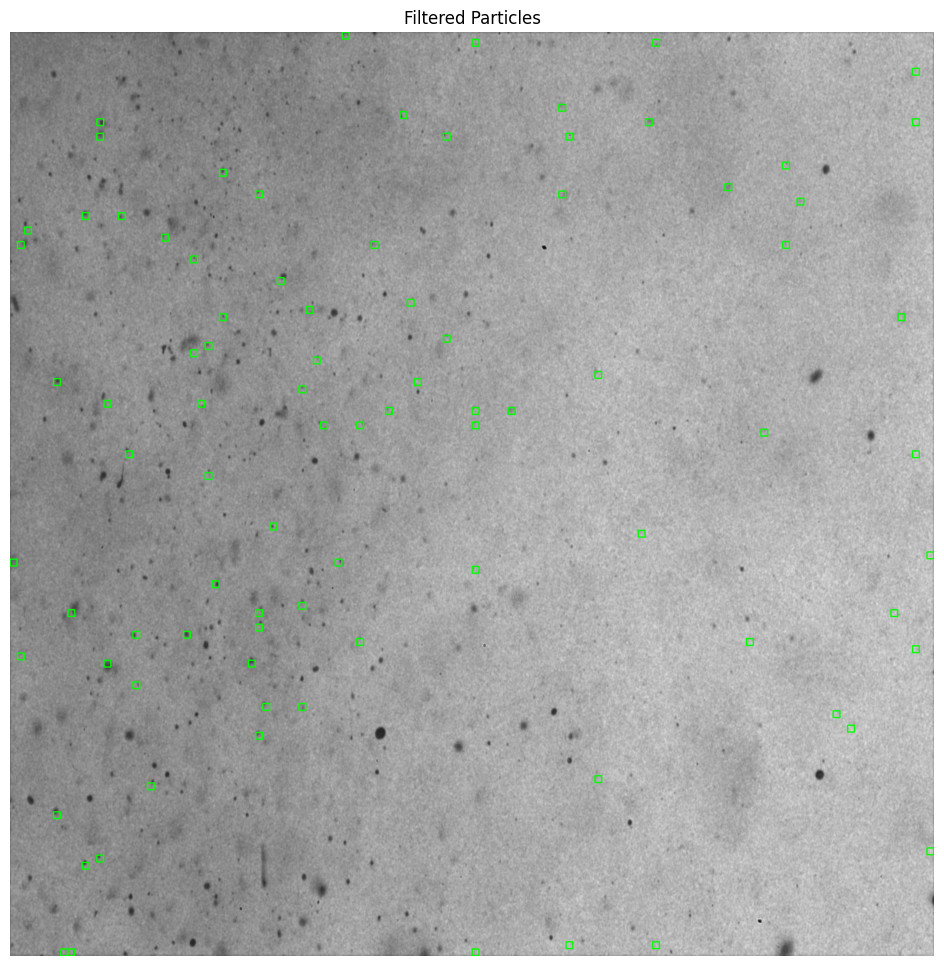

In [183]:
process_and_visualize_clusters(sample_img, cluster_labels_grid)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


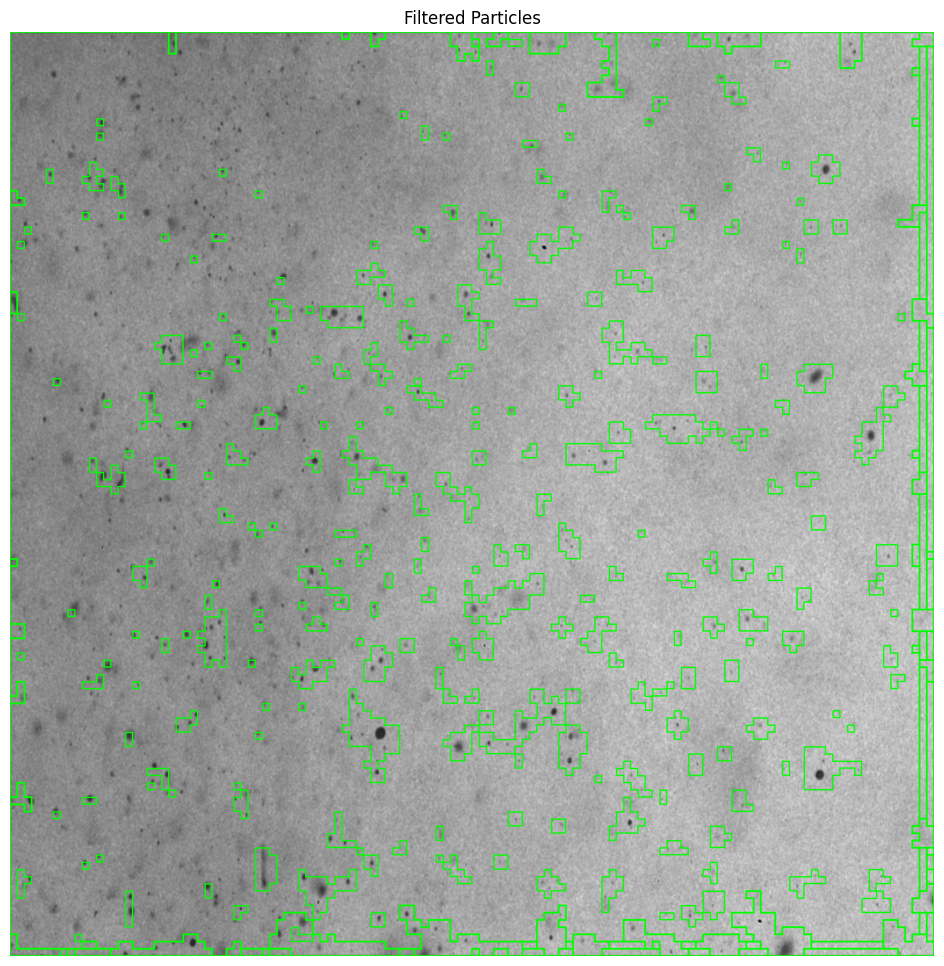

In [184]:
process_and_visualize_clusters(sample_img, cluster_labels_grid, no_filter=True)

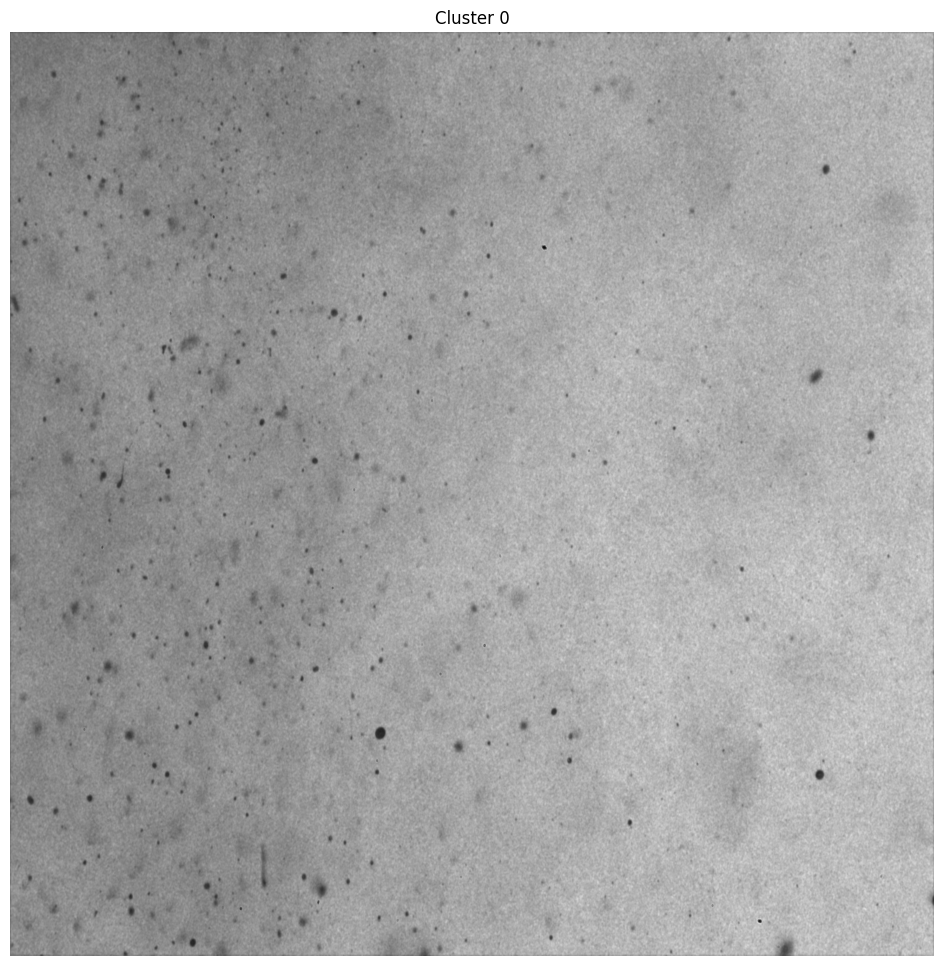

In [187]:
# Example 3: Process and visualize a single cluster with filtering
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


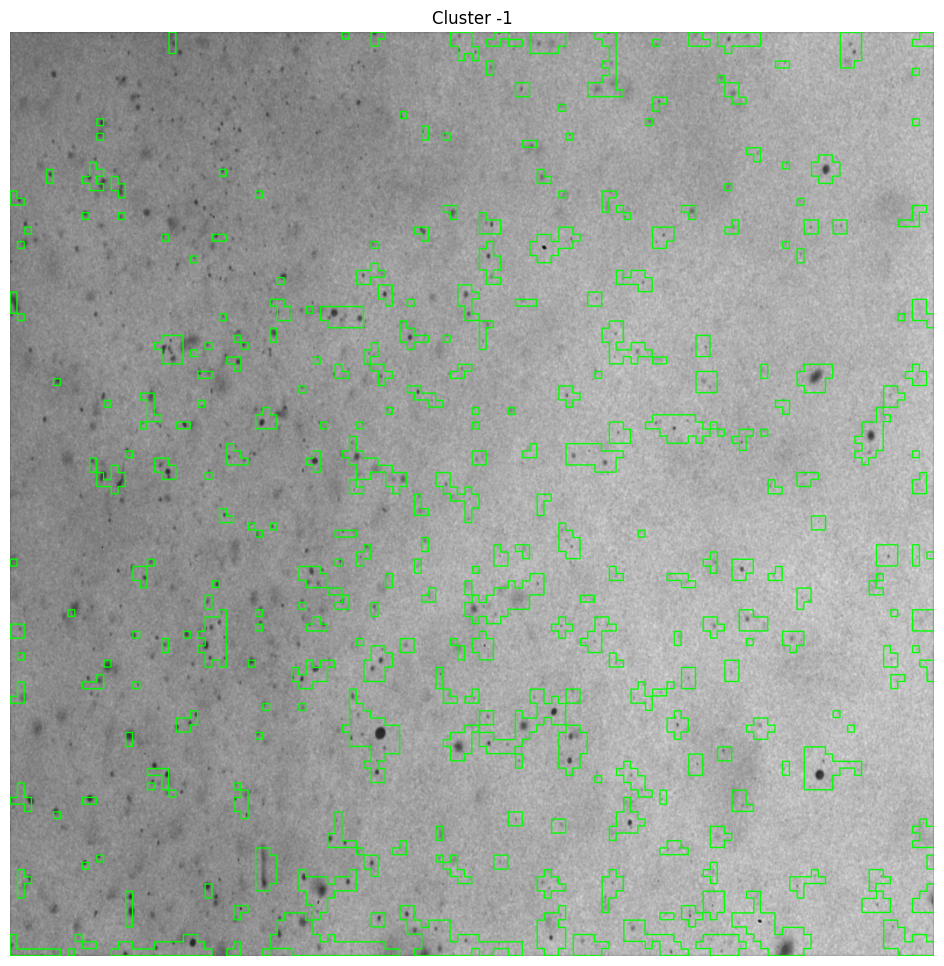

In [189]:
# Example 4: Process and visualize a single cluster without filtering
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=-1, no_filter=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


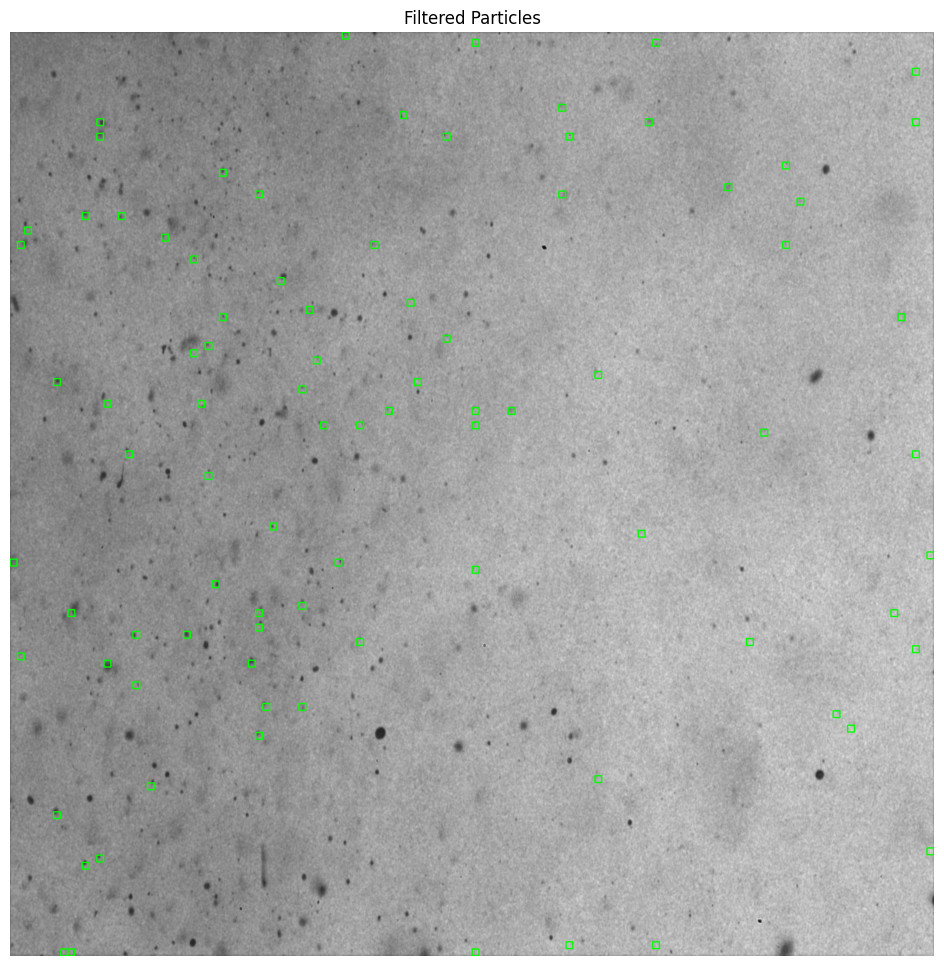

In [190]:
# Example 5: Set a stricter minimum area
process_and_visualize_clusters(sample_img, cluster_labels_grid, min_area=50)

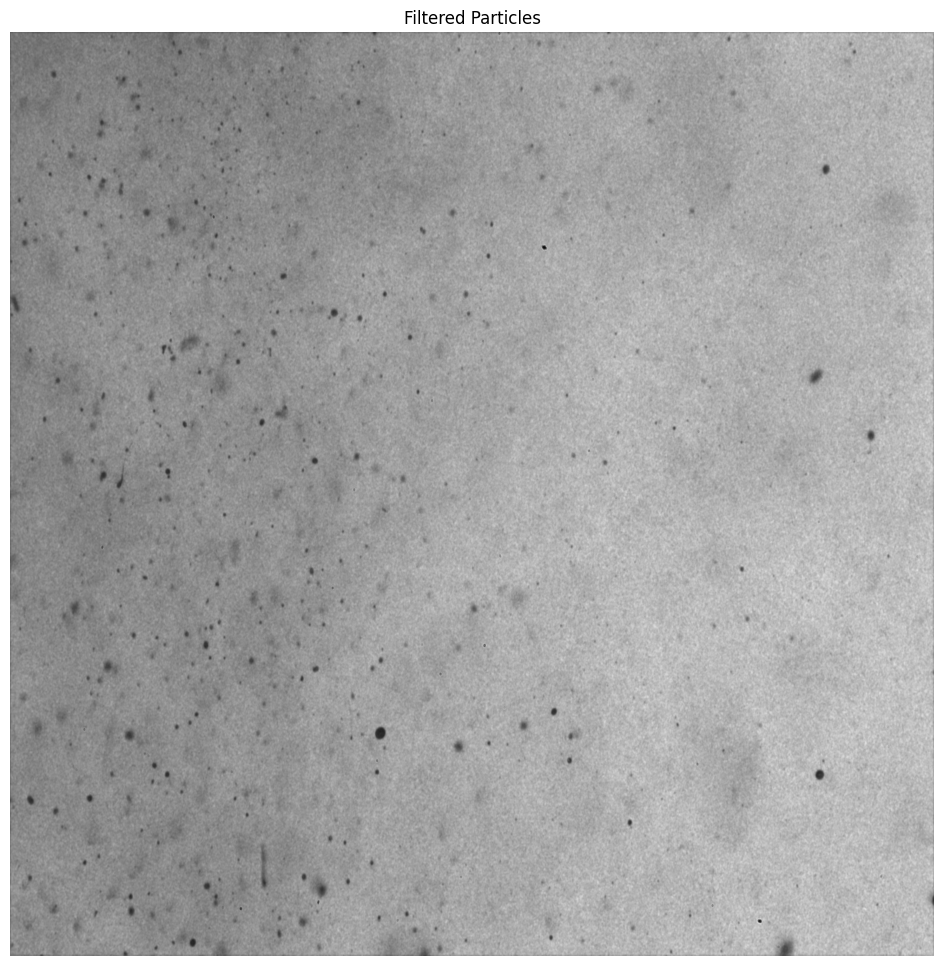

In [191]:
# Example 6: Set a very small maximum area
process_and_visualize_clusters(sample_img, cluster_labels_grid, max_area=30)

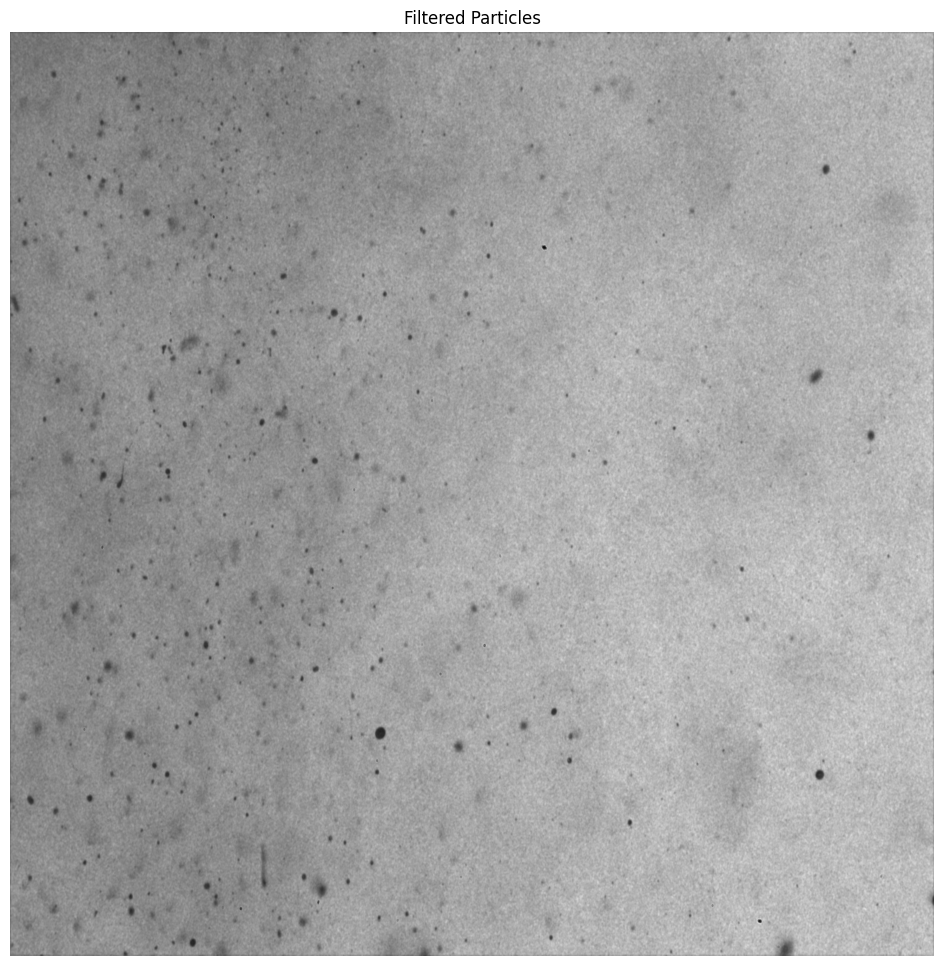

In [192]:
# Example 7: Adjust the circularity requirement
process_and_visualize_clusters(sample_img, cluster_labels_grid, min_circularity=0.9)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Cluster ID: 0, Pixels: 3667456
Cluster ID: 1, Pixels: 26368
Cluster ID: 2, Pixels: 27136
Cluster ID: 3, Pixels: 5888
Cluster ID: 4, Pixels: 3584
Cluster ID: 5, Pixels: 9216
Cluster ID: 6, Pixels: 512
Valid Contours after Filtering: 88


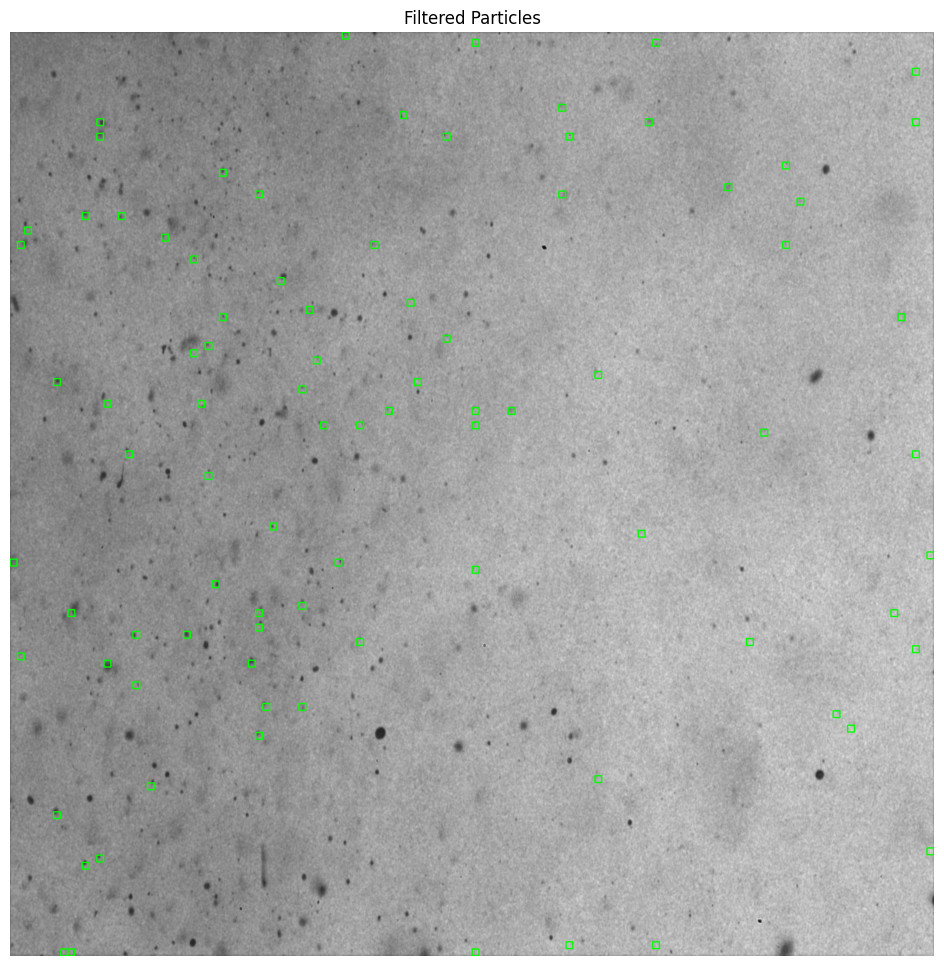

In [193]:
# Example 8: Enable debug mode
process_and_visualize_clusters(sample_img, cluster_labels_grid, debug=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Cluster ID: -1, Pixels: 454144, Total Contours: 278
Valid Contours after Filtering: 81


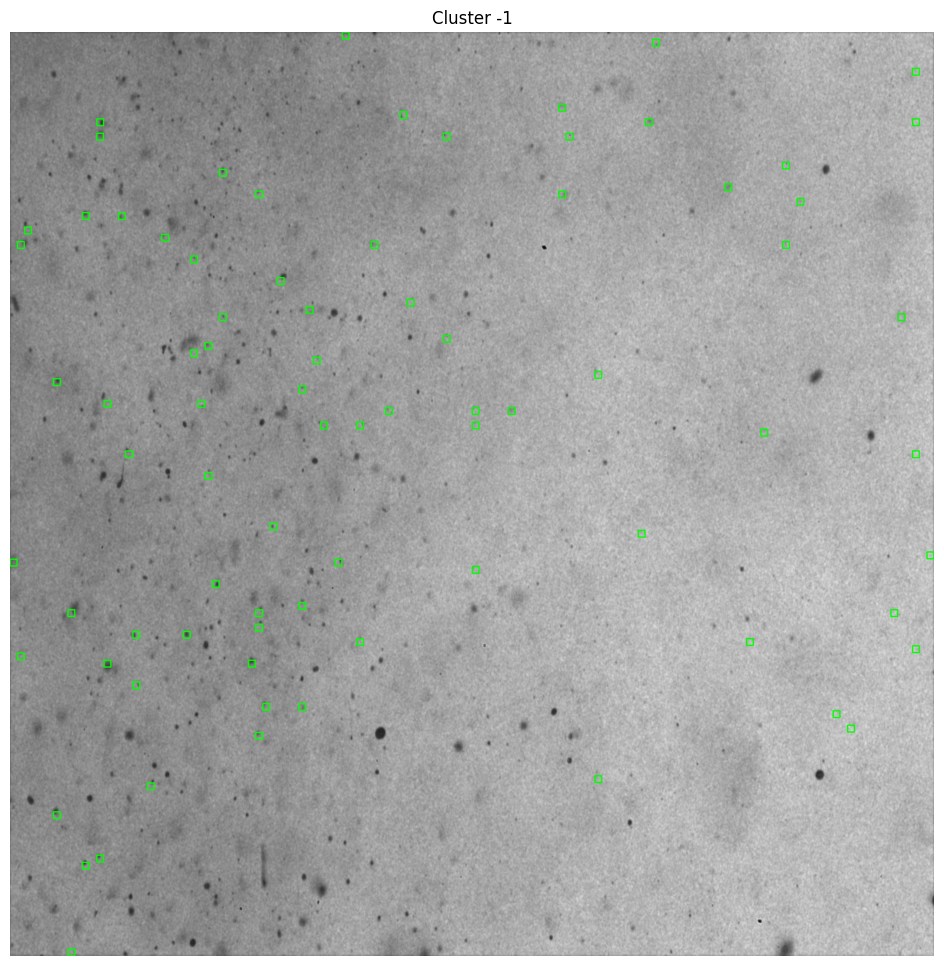

In [195]:
# Example 9: Debug a specific cluster
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=-1, debug=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


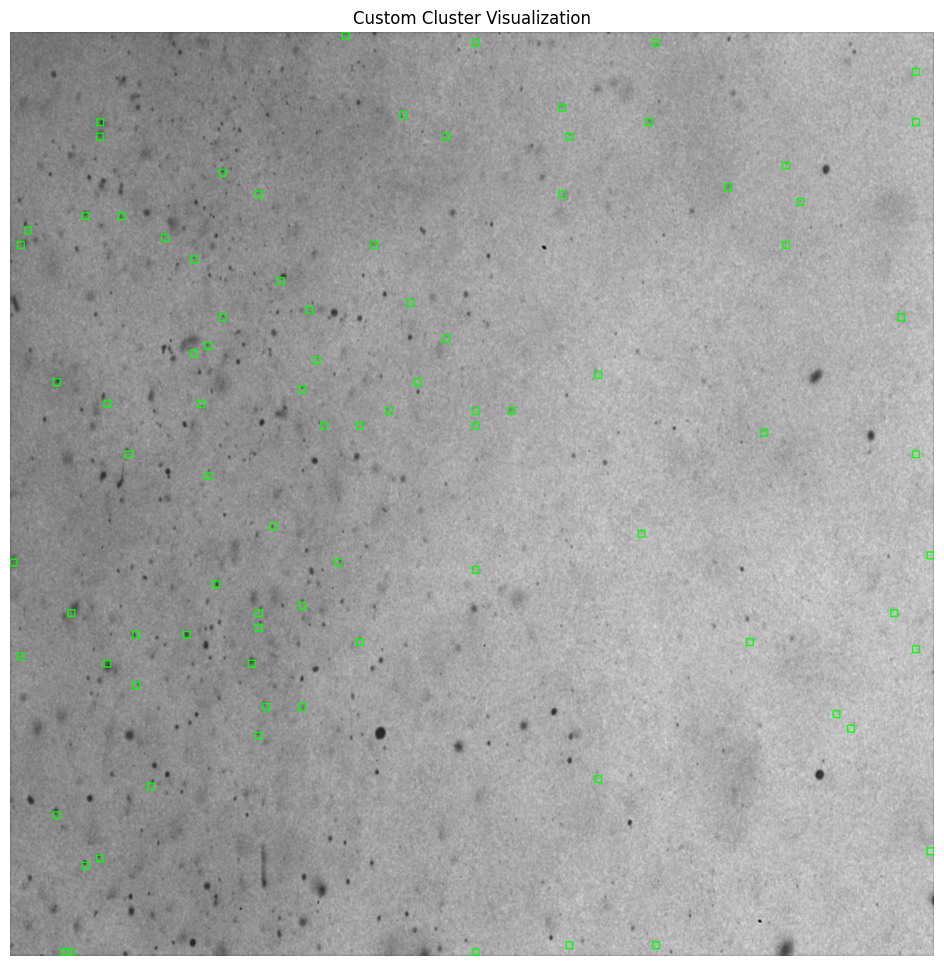

In [200]:
# Example 10: Set a custom title
process_and_visualize_clusters(sample_img, cluster_labels_grid, title="Custom Cluster Visualization")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


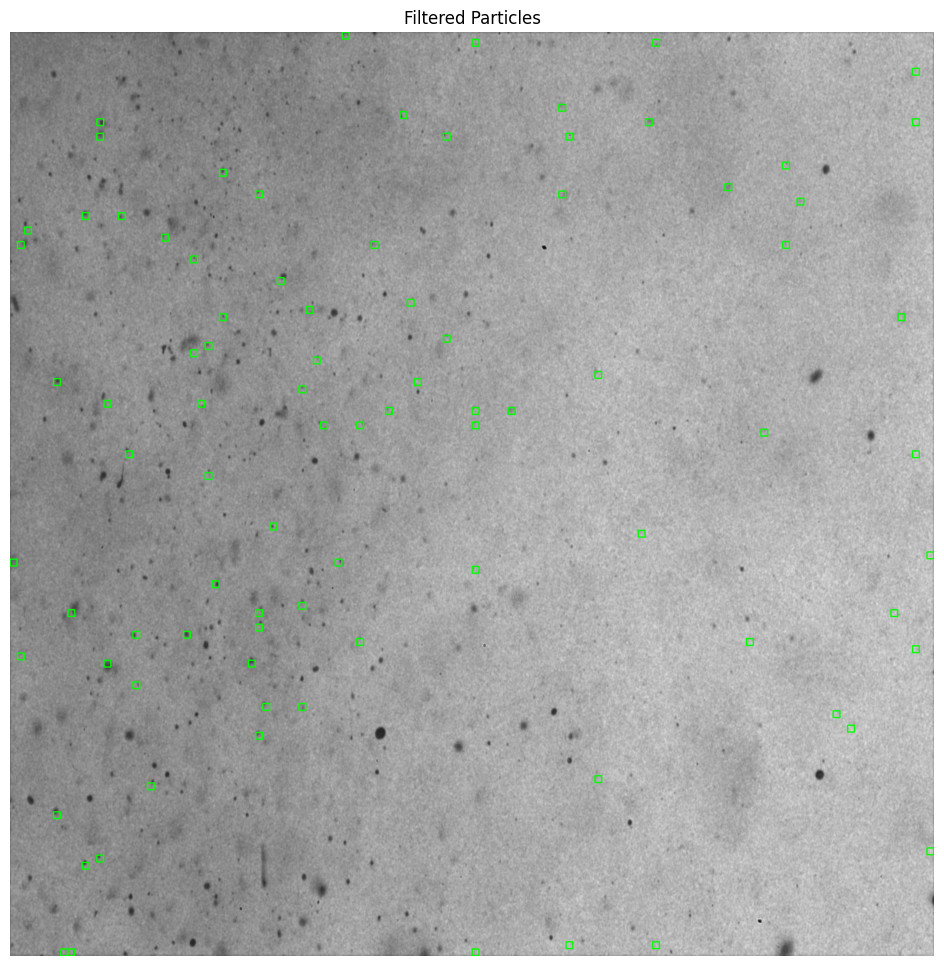

In [203]:
# Example 11: Save the output image
process_and_visualize_clusters(sample_img, cluster_labels_grid, save_path="output.png")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


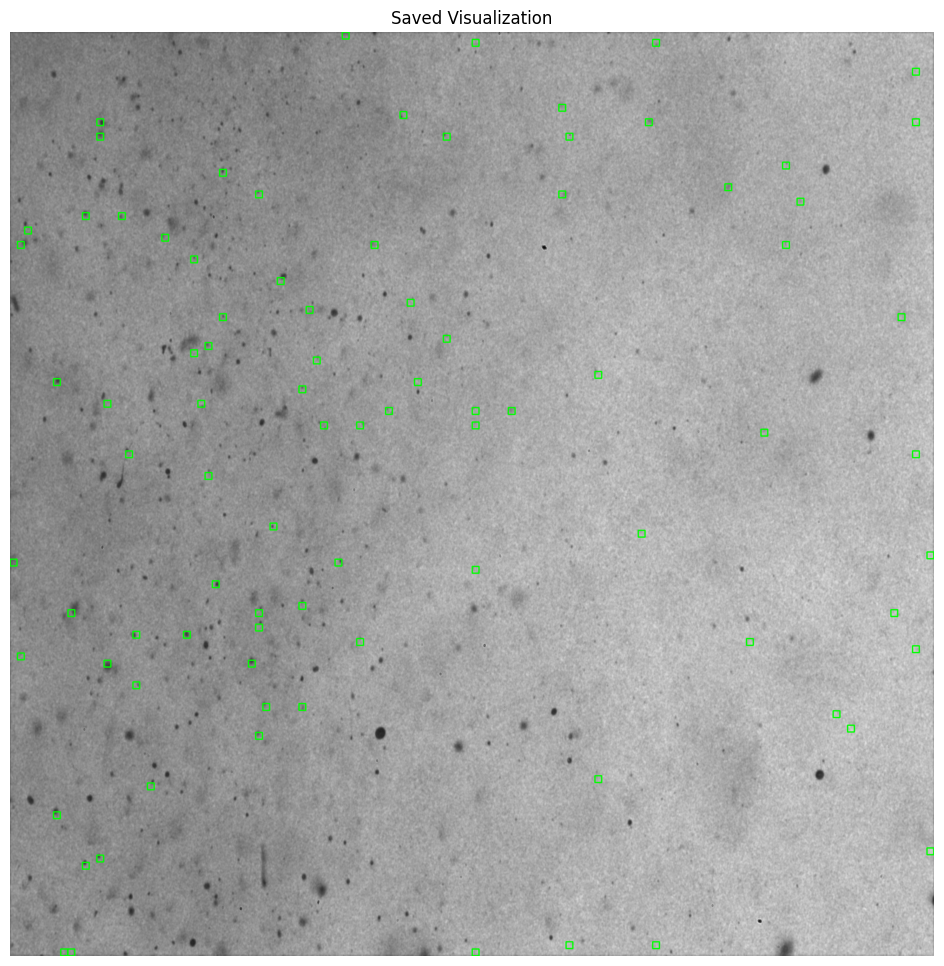

In [204]:
# Example 12: Save visualization with a title
process_and_visualize_clusters(sample_img, cluster_labels_grid, save_path="output_titled.png", title="Saved Visualization")

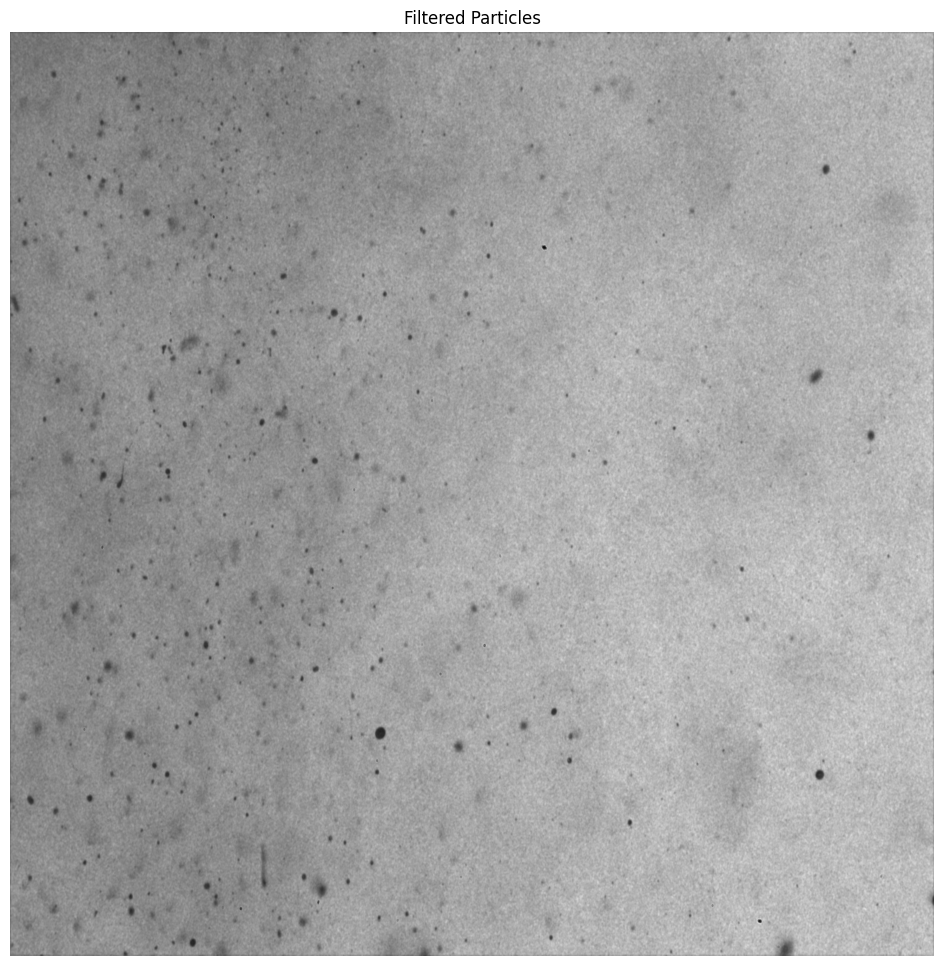

In [205]:
# Example 13: Pass an empty cluster grid
empty_cluster_grid = np.zeros_like(cluster_labels_grid)
process_and_visualize_clusters(sample_img, empty_cluster_grid)

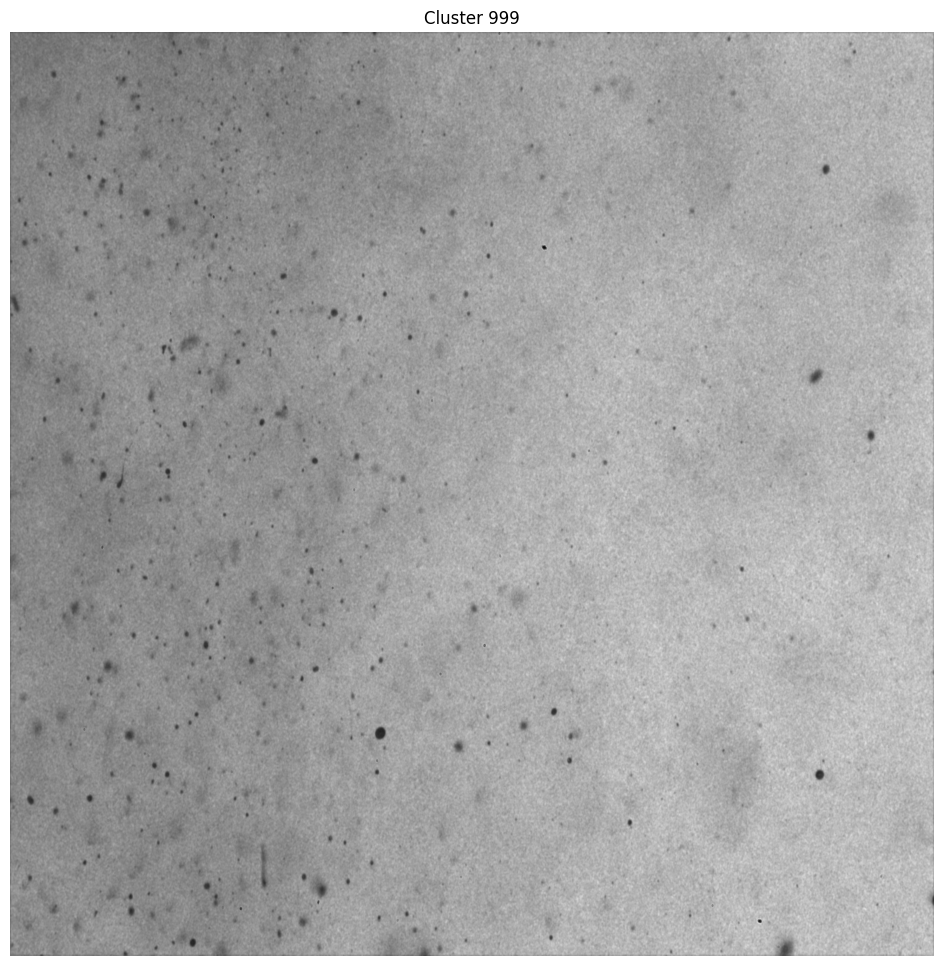

In [206]:
# Example 14: Pass an invalid cluster ID
process_and_visualize_clusters(sample_img, cluster_labels_grid, cluster_id=999)

In [207]:
# Example 15: Pass an invalid image shape
invalid_img = torch.randn(3, 224, 224)  # Incorrect shape (should be [1,1,H,W])
try:
    process_and_visualize_clusters(invalid_img, cluster_labels_grid)
except ValueError as e:
    print("Expected Error:", e)

Expected Error: not enough values to unpack (expected 2, got 1)


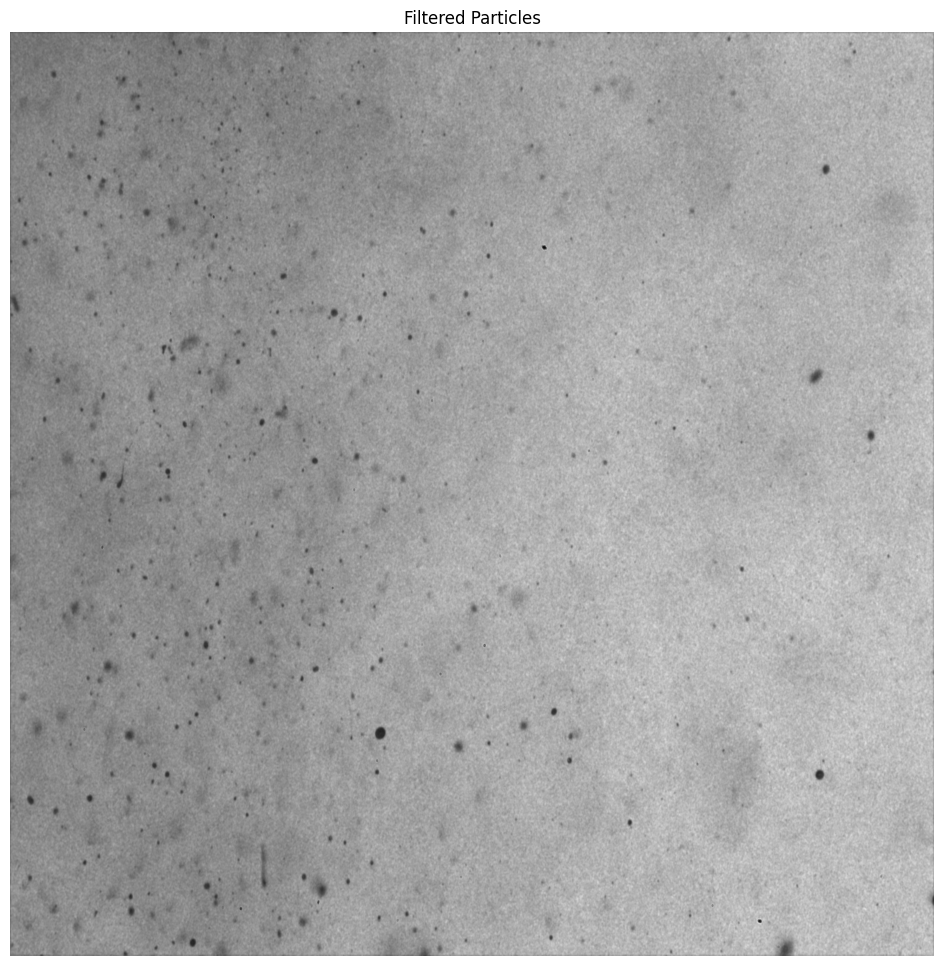

In [208]:
# Example 16: Pass an invalid cluster labels shape
invalid_cluster_grid = np.random.randint(0, 5, (10, 10))  # Incorrect shape (should be [B, H, W])
try:
    process_and_visualize_clusters(sample_img, invalid_cluster_grid)
except ValueError as e:
    print("Expected Error:", e)